In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!mkdir -p ~/.kaggle
!cp /content/drive/MyDrive/Colab_Notebooks/YOLOv8_1/MultiOrganSegmentation/kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d anhoangvo/chaos-t1-and-t2
!rm -rf /content/CHAOS_T1_T2
!unzip chaos-t1-and-t2.zip -d /content/chaos_t1_t2

Dataset URL: https://www.kaggle.com/datasets/anhoangvo/chaos-t1-and-t2
License(s): MIT
Archive:  chaos-t1-and-t2.zip
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_0.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_1.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_10.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_11.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_12.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_13.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_14.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_15.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_16.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_17.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_18.npz  
  inflating: /content/chaos_t1_t2/chaos/t1/1/patient1_t1_inphase_19.npz

In [3]:
import os
import numpy as np

# Define the base directory
base_dir = "/content/chaos_t1_t2/chaos"

# Dictionary to store extracted information in a flat format
dataset = {}

# Iterate over modality folders (t1, t2, etc.)
for modality in os.listdir(base_dir):
    modality_path = os.path.join(base_dir, modality)

    if os.path.isdir(modality_path):
        # Iterate over patient folders (1, 11, etc.)
        for patient in os.listdir(modality_path):
            patient_path = os.path.join(modality_path, patient)

            if os.path.isdir(patient_path):
                # Iterate over .npz files in the patient folder
                for file in os.listdir(patient_path):
                    if file.endswith(".npz"):
                        file_path = os.path.join(patient_path, file)
                        data = np.load(file_path)

                        # Extract data
                        uid = str(data['uid'])
                        img = data['img']
                        lab = data['lab']
                        scb = data['scb']

                        # Create a unique key using modality, patient, and uid
                        key = f"{modality}_{patient}_{uid}"

                        # Store extracted data in a flat structure
                        dataset[key] = {
                            'image': img,
                            'label': lab,
                            'scribble': scb
                        }

                        print(f"Loaded {file} as {key}")

Loaded patient2_t1_inphase_4.npz as t1_2_patient2_t1_inphase_4
Loaded patient2_t1_outphase_7.npz as t1_2_patient2_t1_outphase_7
Loaded patient2_t1_inphase_21.npz as t1_2_patient2_t1_inphase_21
Loaded patient2_t1_outphase_23.npz as t1_2_patient2_t1_outphase_23
Loaded patient2_t1_inphase_16.npz as t1_2_patient2_t1_inphase_16
Loaded patient2_t1_outphase_2.npz as t1_2_patient2_t1_outphase_2
Loaded patient2_t1_outphase_18.npz as t1_2_patient2_t1_outphase_18
Loaded patient2_t1_inphase_12.npz as t1_2_patient2_t1_inphase_12
Loaded patient2_t1_inphase_15.npz as t1_2_patient2_t1_inphase_15
Loaded patient2_t1_outphase_15.npz as t1_2_patient2_t1_outphase_15
Loaded patient2_t1_outphase_6.npz as t1_2_patient2_t1_outphase_6
Loaded patient2_t1_outphase_12.npz as t1_2_patient2_t1_outphase_12
Loaded patient2_t1_outphase_5.npz as t1_2_patient2_t1_outphase_5
Loaded patient2_t1_outphase_17.npz as t1_2_patient2_t1_outphase_17
Loaded patient2_t1_outphase_10.npz as t1_2_patient2_t1_outphase_10
Loaded patient2

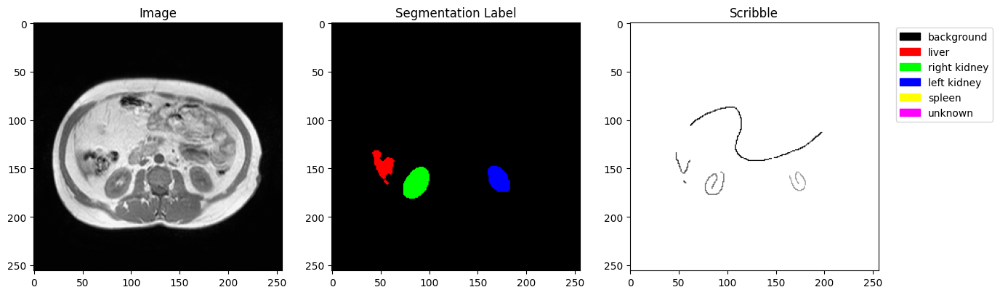

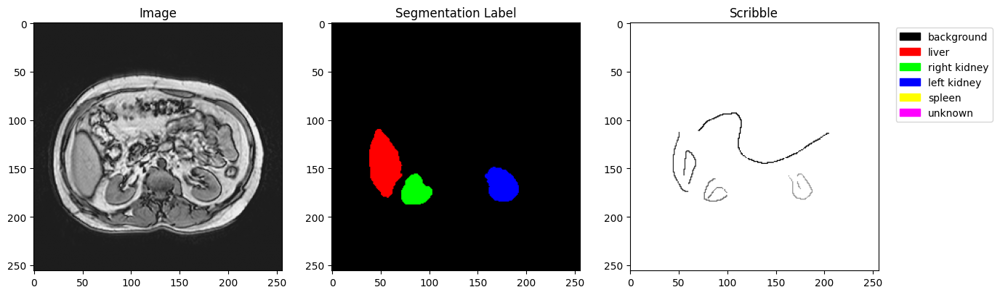

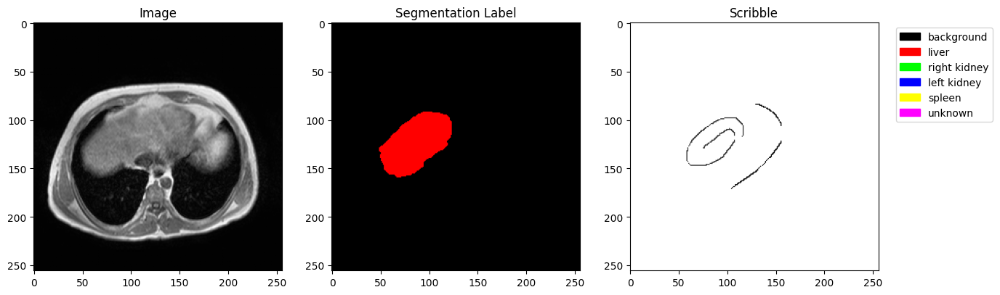

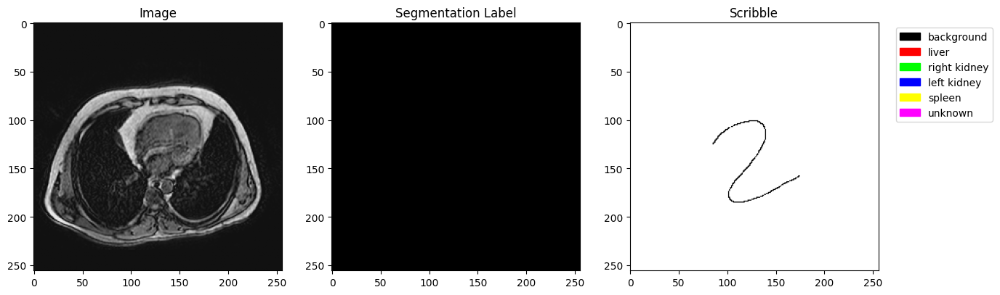

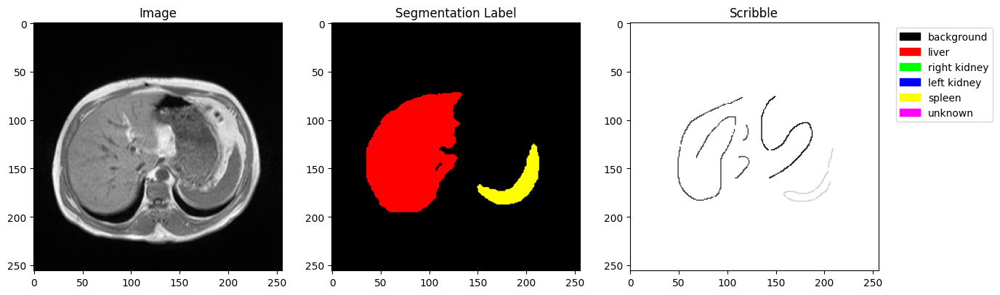

...

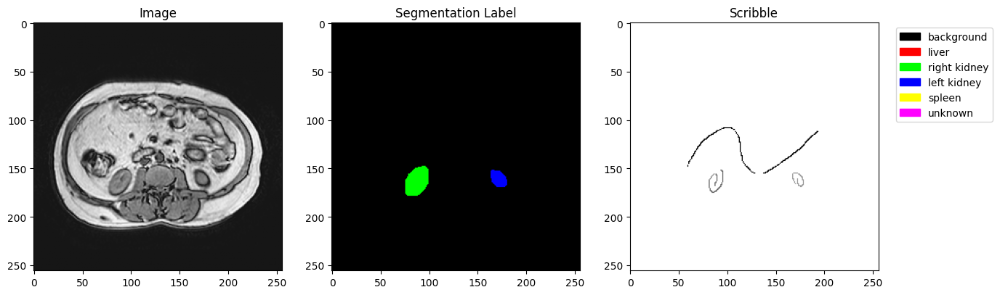

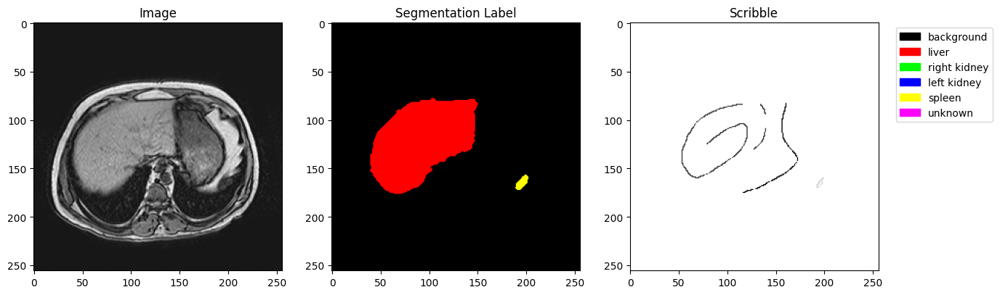

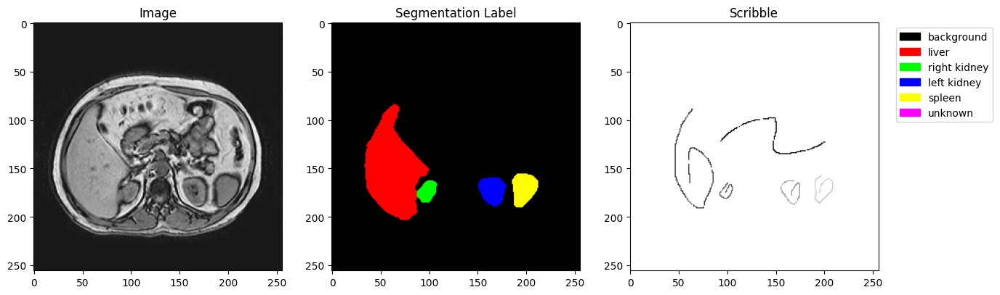

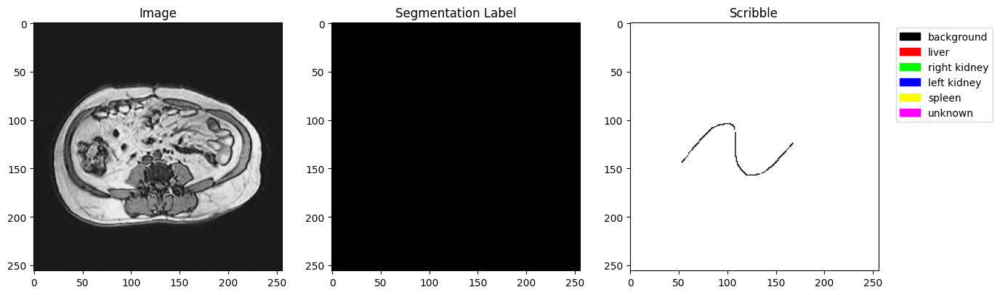

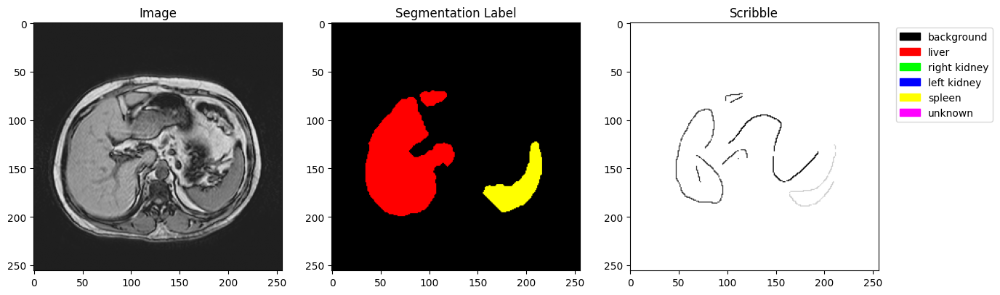

In [4]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches

# Define classnames and corresponding colors
classnames = {
    0: "background",
    1: "liver",
    2: "right kidney",
    3: "left kidney",
    4: "spleen",
    5: "unknown"
}

# Define colors for each class (normalized to [0,1] for matplotlib)
colors = {
    0: (0, 0, 0),        # Black - Background
    1: (1, 0, 0),        # Red - Liver
    2: (0, 1, 0),        # Green - Right Kidney
    3: (0, 0, 1),        # Blue - Left Kidney
    4: (1, 1, 0),        # Yellow - Spleen
    5: (1, 0, 1)         # Magenta - Unknown
}

count = 0

for key, data in dataset.items():
    img = data['image']
    lab = data['label']
    scb = data['scribble']

    # Create color-mapped label image
    lab_color = np.zeros((*lab.shape, 3))  # RGB image initialized

    for class_id, color in colors.items():
        lab_color[lab == class_id] = color  # Assign colors to class pixels

    plt.figure(figsize=(15, 5))

    # Original Image
    plt.subplot(1, 3, 1)
    plt.imshow(img, cmap='gray')
    plt.title('Image')

    # Label Mask with Colors
    plt.subplot(1, 3, 2)
    plt.imshow(lab_color)
    plt.title('Segmentation Label')

    # Scribble Mask
    plt.subplot(1, 3, 3)
    plt.imshow(scb, cmap='gray')
    plt.title('Scribble')

    # Add a legend for labels (Fix)
    legend_patches = [mpatches.Patch(color=colors[class_id], label=name) for class_id, name in classnames.items()]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.show()

    count += 1
    if count == 30:
        break


In [5]:
filtered_dataset = {key: data for key, data in dataset.items() if np.any(data['label'] > 0)}

print(f"Original dataset size: {len(dataset)}")
print(f"Filtered dataset size: {len(filtered_dataset)}")


Original dataset size: 1917
Filtered dataset size: 1492


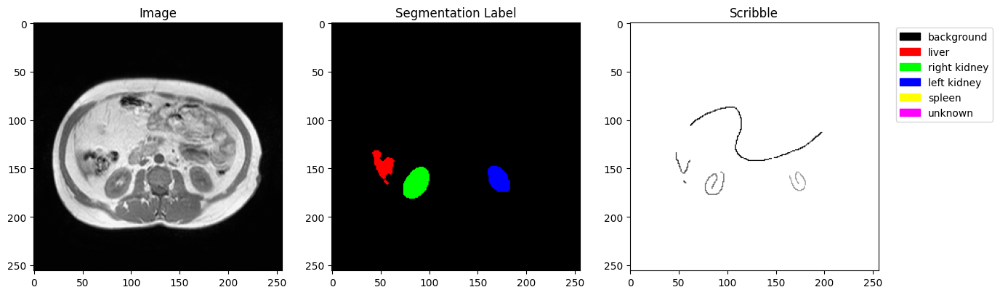

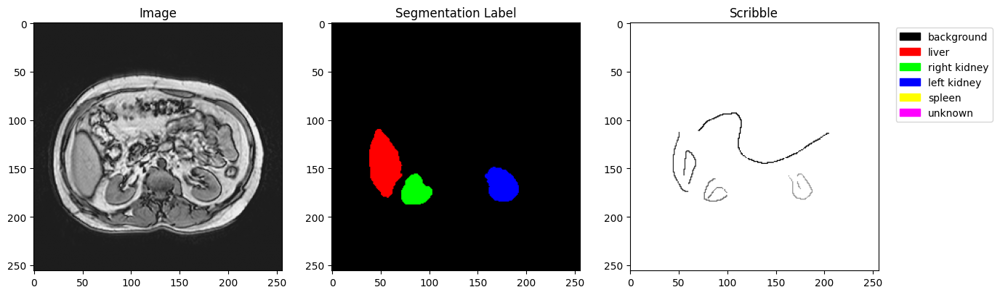

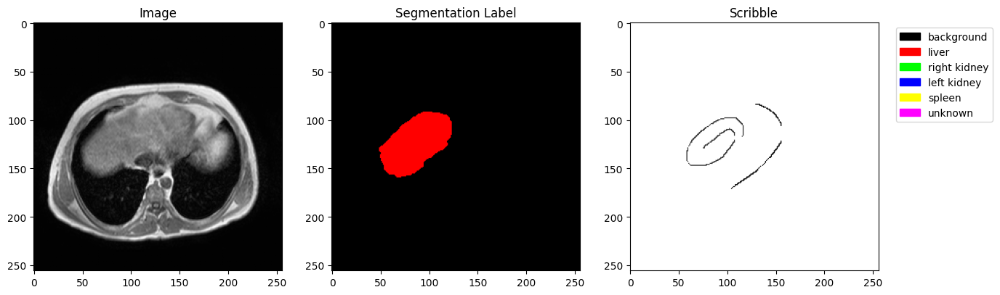

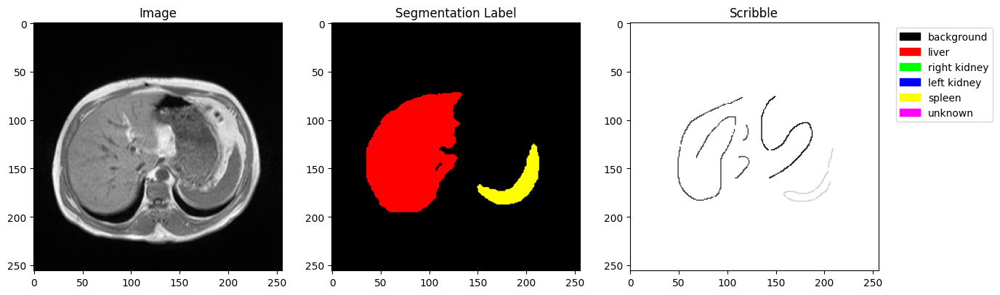

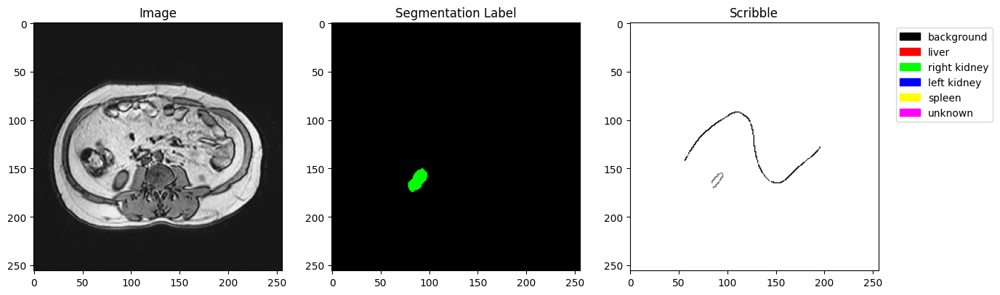

...

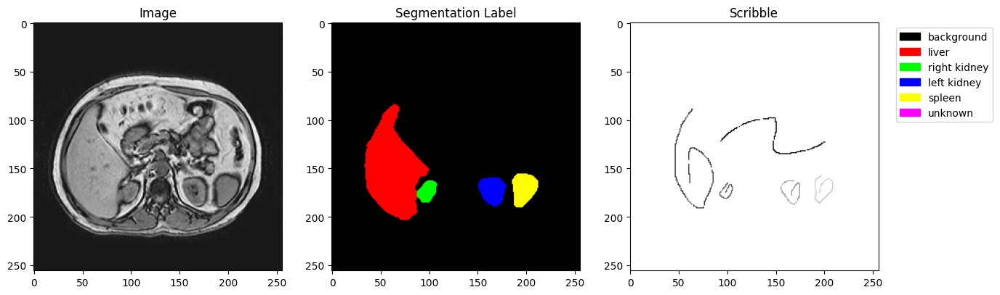

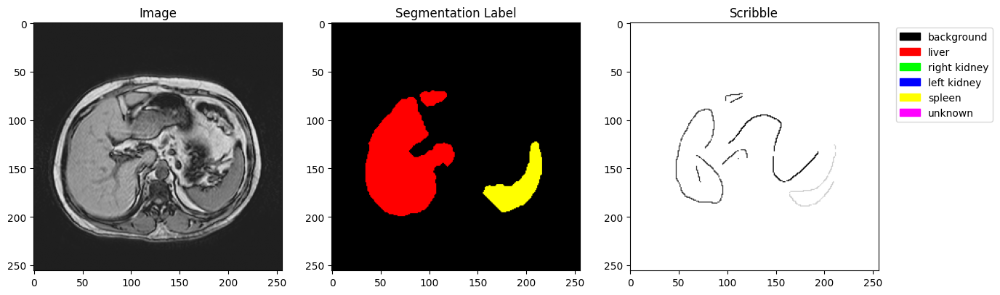

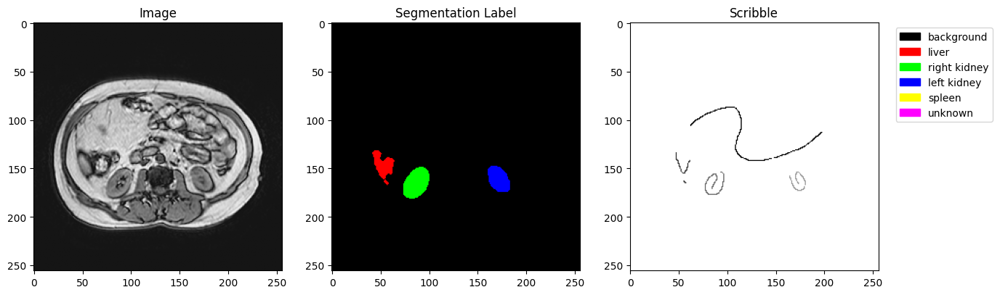

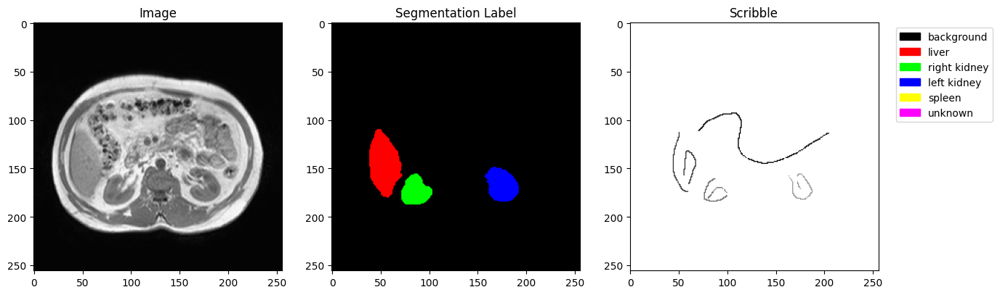

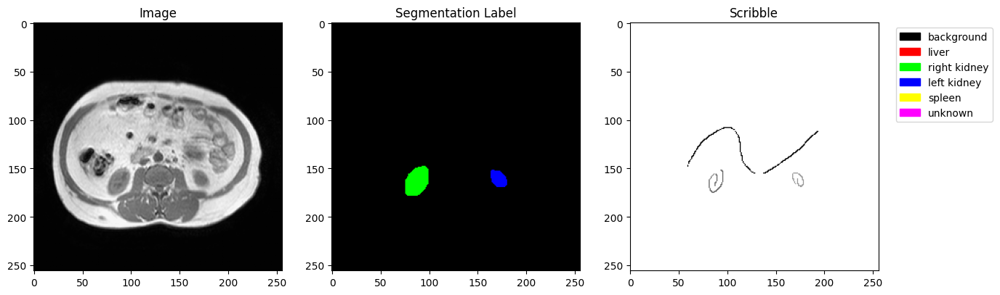

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches

# Define classnames and corresponding colors
classnames = {
    0: "background",
    1: "liver",
    2: "right kidney",
    3: "left kidney",
    4: "spleen",
    5: "unknown"
}

# Define colors for each class (normalized to [0,1] for matplotlib)
colors = {
    0: (0, 0, 0),        # Black - Background
    1: (1, 0, 0),        # Red - Liver
    2: (0, 1, 0),        # Green - Right Kidney
    3: (0, 0, 1),        # Blue - Left Kidney
    4: (1, 1, 0),        # Yellow - Spleen
    5: (1, 0, 1)         # Magenta - Unknown
}

count = 0

for key, data in filtered_dataset.items():
    img = data['image']
    lab = data['label']
    scb = data['scribble']

    # Create color-mapped label image
    lab_color = np.zeros((*lab.shape, 3))  # RGB image initialized

    for class_id, color in colors.items():
        lab_color[lab == class_id] = color  # Assign colors to class pixels

    plt.figure(figsize=(15, 5))

    # Original Image
    plt.subplot(1, 3, 1)
    plt.imshow(img, cmap='gray')
    plt.title('Image')

    # Label Mask with Colors
    plt.subplot(1, 3, 2)
    plt.imshow(lab_color)
    plt.title('Segmentation Label')

    # Scribble Mask
    plt.subplot(1, 3, 3)
    plt.imshow(scb, cmap='gray')
    plt.title('Scribble')

    # Add a legend for labels (Fix)
    legend_patches = [mpatches.Patch(color=colors[class_id], label=name) for class_id, name in classnames.items()]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.show()

    count += 1
    if count == 30:
        break


In [7]:
import numpy as np
from collections import Counter
from sklearn.model_selection import train_test_split

# Function to extract unique class labels from a segmentation mask
def get_class_presence(mask):
    """Returns a sorted tuple of unique class labels present in the mask, ignoring background (0)"""
    unique_classes = np.unique(mask)
    unique_classes = unique_classes[unique_classes > 0]  # Ignore background (0)
    return tuple(sorted(unique_classes))  # Return sorted tuple for consistency

# Create lists for dataset keys, data, and derived class labels
all_keys = []
all_data = []
class_labels = []  # This will be used for stratification

# Process the dataset
for key, data in filtered_dataset.items():
    mask = data['label']  # Extract the 2D mask
    class_tuple = get_class_presence(mask)  # Get unique class presence
    all_keys.append(key)
    all_data.append(data)
    class_labels.append("_".join(map(str, class_tuple)))  # Convert tuple to string

# Get unique class distributions
label_counts = Counter(class_labels)

# Separate rare cases (only 1 sample) from valid cases
rare_indices = [i for i, label in enumerate(class_labels) if label_counts[label] == 1]
valid_indices = [i for i, label in enumerate(class_labels) if label_counts[label] > 1]

# Convert lists to numpy arrays
all_keys = np.array(all_keys)
all_data = np.array(all_data)
class_labels = np.array(class_labels)

# Assign all rare cases to training
train_keys = all_keys[rare_indices].tolist()
train_data = all_data[rare_indices].tolist()
train_labels = class_labels[rare_indices].tolist()

# Get valid cases for stratified splitting
valid_keys = all_keys[valid_indices]
valid_data = all_data[valid_indices]
valid_labels = class_labels[valid_indices]

# Perform train-test split on valid cases
train_keys_split, temp_keys, train_data_split, temp_data, train_labels_split, temp_labels = train_test_split(
    valid_keys, valid_data, valid_labels, test_size=0.2, stratify=valid_labels, random_state=42
)

# Merge stratified training set with rare cases
train_keys.extend(train_keys_split)
train_data.extend(train_data_split)
train_labels.extend(train_labels_split)

# Final arrays
train_keys = np.array(train_keys)
train_data = np.array(train_data)
train_labels = np.array(train_labels)

# Split Temp into Validation (10%) and Test (10%)
val_keys, test_keys, val_data, test_data = train_test_split(
    temp_keys, temp_data, test_size=0.5, stratify=temp_labels, random_state=42
)

# Store final splits in dictionaries
train_set = {key: data for key, data in zip(train_keys, train_data)}
val_set = {key: data for key, data in zip(val_keys, val_data)}
test_set = {key: data for key, data in zip(test_keys, test_data)}

# Print dataset sizes
print(f"Train set: {len(train_set)} samples")
print(f"Validation set: {len(val_set)} samples")
print(f"Test set: {len(test_set)} samples")


Train set: 1194 samples
Validation set: 149 samples
Test set: 149 samples


In [8]:
import os
import cv2
import numpy as np
import shutil

# Define the output directories for images, masks, and scribbles
output_image_dir = '/content/chaos_t1_t2/images'
output_mask_dir = '/content/chaos_t1_t2/masks'
output_scribble_dir = '/content/chaos_t1_t2/scribbles'

# Function to remove existing directories and create new ones
def recreate_dirs():
    splits = ['train', 'val', 'test']
    for split in splits:
        image_dir = os.path.join(output_image_dir, split)
        mask_dir = os.path.join(output_mask_dir, split)
        scribble_dir = os.path.join(output_scribble_dir, split)

        # Remove old directories if they exist
        if os.path.exists(image_dir):
            print(f"Deleting existing directory: {image_dir}")
            shutil.rmtree(image_dir)
        if os.path.exists(mask_dir):
            print(f"Deleting existing directory: {mask_dir}")
            shutil.rmtree(mask_dir)
        if os.path.exists(scribble_dir):
            print(f"Deleting existing directory: {scribble_dir}")
            shutil.rmtree(scribble_dir)

        # Create new directories
        print(f"Creating new directory: {image_dir}")
        os.makedirs(image_dir, exist_ok=True)
        print(f"Creating new directory: {mask_dir}")
        os.makedirs(mask_dir, exist_ok=True)
        print(f"Creating new directory: {scribble_dir}")
        os.makedirs(scribble_dir, exist_ok=True)

# Function to save image, mask, and scribble arrays as PNG
def save_images_from_dict(data_set, split):
    for key, data in data_set.items():
        # Check if 'image', 'label', and 'scribble' are in the data
        if 'image' in data and 'label' in data and 'scribble' in data:
            # Extract image, label (mask), and scribble arrays
            image_data = data['image']   # Image numpy array
            mask_data = data['label']    # Mask numpy array
            scribble_data = data['scribble']  # Scribble numpy array

            # Check if the data arrays are non-empty
            if image_data is not None and mask_data is not None and scribble_data is not None:
                # Convert to uint8 for saving as PNG (if necessary, depending on the image size)
                image_data = np.uint8(image_data)
                mask_data = np.uint8(mask_data)
                scribble_data = np.uint8(scribble_data)

                # Construct the filename based on the key
                file_name = f"{key}.png"

                # Define output paths for each type
                image_output_path = os.path.join(output_image_dir, split, file_name)
                mask_output_path = os.path.join(output_mask_dir, split, file_name)
                scribble_output_path = os.path.join(output_scribble_dir, split, file_name)

                # Save the image, mask, and scribble arrays as PNG files
                print(f"Saving image: {image_output_path}")
                cv2.imwrite(image_output_path, image_data)
                print(f"Saving mask: {mask_output_path}")
                cv2.imwrite(mask_output_path, mask_data)
                print(f"Saving scribble: {scribble_output_path}")
                cv2.imwrite(scribble_output_path, scribble_data)

# Recreate directories and save images from train, val, and test sets
print("Recreating directories...")
recreate_dirs()

print("Saving images, masks, and scribbles...")
save_images_from_dict(train_set, 'train')
save_images_from_dict(val_set, 'val')
save_images_from_dict(test_set, 'test')

print("Old folders deleted, new folders created, and images, masks, and scribbles saved successfully!")


Recreating directories...
Creating new directory: /content/chaos_t1_t2/images/train
Creating new directory: /content/chaos_t1_t2/masks/train
Creating new directory: /content/chaos_t1_t2/scribbles/train
Creating new directory: /content/chaos_t1_t2/images/val
Creating new directory: /content/chaos_t1_t2/masks/val
Creating new directory: /content/chaos_t1_t2/scribbles/val
Creating new directory: /content/chaos_t1_t2/images/test
Creating new directory: /content/chaos_t1_t2/masks/test
Creating new directory: /content/chaos_t1_t2/scribbles/test
Saving images, masks, and scribbles...
Saving image: /content/chaos_t1_t2/images/train/t2_20_patient20_t2_25.png
Saving mask: /content/chaos_t1_t2/masks/train/t2_20_patient20_t2_25.png
Saving scribble: /content/chaos_t1_t2/scribbles/train/t2_20_patient20_t2_25.png
Saving image: /content/chaos_t1_t2/images/train/t2_37_patient37_t2_12.png
Saving mask: /content/chaos_t1_t2/masks/train/t2_37_patient37_t2_12.png
Saving scribble: /content/chaos_t1_t2/scribb

In [9]:
!ls -l /content/chaos_t1_t2/images/train | wc -l
!ls -l /content/chaos_t1_t2/images/val | wc -l
!ls -l /content/chaos_t1_t2/images/test | wc -l

!ls -l /content/chaos_t1_t2/masks/train | wc -l
!ls -l /content/chaos_t1_t2/masks/val | wc -l
!ls -l /content/chaos_t1_t2/masks/test | wc -l

1195
150
150
1195
150
150


In [10]:
import os
from collections import Counter

# Folders to check
image_folders = {
    'train': '/content/chaos_t1_t2/images/train',
    'test': '/content/chaos_t1_t2/images/test',
    'val': '/content/chaos_t1_t2/images/val'
}

# Assuming train_set, test_set, val_set are dictionaries with keys as filenames (without the .png)
# Extract keys from train_set, test_set, and val_set
train_keys = set(f"{key}.png" for key in train_set.keys())
test_keys = set(f"{key}.png" for key in test_set.keys())
val_keys = set(f"{key}.png" for key in val_set.keys())

# Function to check for extra or duplicate files in each folder
def check_filenames_in_folder(folder_path, keys_set):
    filenames = set(os.listdir(folder_path))

    # Check for extra files (files not in keys_set)
    extra_files = filenames - keys_set
    if extra_files:
        print(f"Extra files found in {folder_path}:")
        for file in extra_files:
            print(f"  {file}")

    # Check for duplicates
    file_counts = Counter(filenames)
    duplicates = {file: count for file, count in file_counts.items() if count > 1}
    if duplicates:
        print(f"Duplicate files found in {folder_path}:")
        for file, count in duplicates.items():
            print(f"  {file} appears {count} times")

    # Check for missing files (files in keys_set but not in folder)
    missing_files = keys_set - filenames
    if missing_files:
        print(f"Missing files in {folder_path}:")
        for file in missing_files:
            print(f"  {file}")

# Check files in each folder against the corresponding keys
for folder_type, folder_path in image_folders.items():
    print(f"\nChecking {folder_type} folder...")

    if folder_type == 'train':
        check_filenames_in_folder(folder_path, train_keys)
    elif folder_type == 'test':
        check_filenames_in_folder(folder_path, test_keys)
    elif folder_type == 'val':
        check_filenames_in_folder(folder_path, val_keys)



Checking train folder...

Checking test folder...

Checking val folder...


In [11]:
import os
import cv2
import numpy as np

# Define your class names and class ids (pixel values)
classnames = {
    1: "liver",
    2: "right kidney",
    3: "left kidney",
    4: "spleen",
    5: "unknown"
}

# Set up input and output directories
input_dir = "/content/chaos_t1_t2/masks"
output_dir = "/content/chaos_t1_t2/labels"  # Ensure the labels folder is used for saving .txt files
splits = ['train', 'test', 'val']

# Ensure output directories exist
for split in splits:
    os.makedirs(os.path.join(output_dir, split), exist_ok=True)

# Function to process a single mask image and extract polygons
def process_mask(mask_filepath, split):
    print(f"Processing {mask_filepath}...")

    # Extract just the file name (no path)
    mask_filename = os.path.basename(mask_filepath)

    # Load the mask image in grayscale (0: background, 1: liver, etc.)
    mask = cv2.imread(mask_filepath, cv2.IMREAD_GRAYSCALE)

    if mask is None:
        print(f"Error reading {mask_filepath}. Skipping...")
        return

    # Get the height and width of the mask image
    H, W = mask.shape
    all_polygons = []

    # Loop over each class (pixel value) and extract contours for that class
    for class_id, class_name in classnames.items():
        class_mask = (mask == class_id).astype(np.uint8)  # Mask for the current class
        contours, _ = cv2.findContours(class_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        for contour in contours:
            if cv2.contourArea(contour) > 200:  # Filter small contours based on area
                polygon = []
                for point in contour:
                    x, y = point[0]
                    polygon.append(x / W)
                    polygon.append(y / H)
                all_polygons.append((class_id, polygon))

    # Check if any polygons were found
    if not all_polygons:
        print(f"No polygons found in {mask_filepath}. Skipping...")
        return

    # Prepare the output label file path in the correct labels folder
    label_filename = os.path.join(output_dir, split, mask_filename.replace('.png', '.txt'))

    # Save the polygons to the text file
    with open(label_filename, 'w') as f:
        for class_id, polygon in all_polygons:
            f.write(f"{class_id-1} {' '.join(map(str, polygon))}\n")

    print(f"Saved labels to {label_filename}")

# Loop through each split (train, test, val) and process corresponding mask images
for split in splits:
    mask_folder = os.path.join(input_dir, split)

    # Ensure the folder exists and contains .png files
    if not os.path.exists(mask_folder):
        print(f"Folder for split '{split}' does not exist. Skipping...")
        continue

    # List all mask images in the folder
    mask_files = [f for f in os.listdir(mask_folder) if f.endswith('.png')]

    for mask_file in mask_files:
        mask_filepath = os.path.join(mask_folder, mask_file)
        process_mask(mask_filepath, split)

print("Processing completed.")


Processing /content/chaos_t1_t2/masks/train/t1_34_patient34_t1_outphase_15.png...
Saved labels to /content/chaos_t1_t2/labels/train/t1_34_patient34_t1_outphase_15.txt
Processing /content/chaos_t1_t2/masks/train/t1_38_patient38_t1_inphase_12.png...
Saved labels to /content/chaos_t1_t2/labels/train/t1_38_patient38_t1_inphase_12.txt
Processing /content/chaos_t1_t2/masks/train/t2_20_patient20_t2_6.png...
Saved labels to /content/chaos_t1_t2/labels/train/t2_20_patient20_t2_6.txt
Processing /content/chaos_t1_t2/masks/train/t1_34_patient34_t1_inphase_8.png...
Saved labels to /content/chaos_t1_t2/labels/train/t1_34_patient34_t1_inphase_8.txt
Processing /content/chaos_t1_t2/masks/train/t1_36_patient36_t1_outphase_14.png...
Saved labels to /content/chaos_t1_t2/labels/train/t1_36_patient36_t1_outphase_14.txt
Processing /content/chaos_t1_t2/masks/train/t1_2_patient2_t1_inphase_3.png...
Saved labels to /content/chaos_t1_t2/labels/train/t1_2_patient2_t1_inphase_3.txt
Processing /content/chaos_t1_t2/

In [12]:
!ls -l /content/chaos_t1_t2/labels/train | wc -l
!ls -l /content/chaos_t1_t2/labels/val | wc -l
!ls -l /content/chaos_t1_t2/labels/test | wc -l

1148
143
143


In [13]:
import yaml

def generate_yaml(save_path, dataset_path, class_names):
    data = {
        "path": dataset_path,
        "train": "images/train",
        "val": "images/val",
        "nc": len(class_names),
        "names": class_names
    }

    # Save YAML file
    with open(save_path, "w") as yaml_file:
        yaml.dump(data, yaml_file, default_flow_style=False)

    print(f"✅ YAML file saved at: {save_path}")

# Example usage:
save_path = "/content/chaos_t1_t2/config.yaml"  # Change this to your desired save location
dataset_path = "/content/chaos_t1_t2"
class_names = [
    "liver",
    "right kidney",
    "left kidney",
    "spleen",
    "unknown"
]

generate_yaml(save_path, dataset_path, class_names)

✅ YAML file saved at: /content/chaos_t1_t2/config.yaml


In [14]:
!nvidia-smi
!pip install ultralytics
!ls '/content/chaos_t1_t2'

Sat Mar 22 21:26:59 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   37C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [15]:
import os
from IPython import display
display.clear_output()

!yolo mode=checks

from ultralytics import YOLO
from IPython.display import display, Image
import cv2

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/ultralytics/cfg/__init__.py", line 920, in entrypoint
    raise ValueError(f"Invalid 'mode={mode}'. Valid modes are {MODES}.\n{CLI_HELP_MSG}")
ValueError: Invalid 'mode=<module 'ultralytics.utils.checks' from '/usr/local/lib/python3.11/dist-packages/ultralytics/utils/checks.py'>'. Valid modes are frozenset({'predict', 'export', 'train', 'benchmark', 'val', 'track'}).

    Arguments received: ['yolo', 'mode=checks']. Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS


In [16]:
model = YOLO('yolo11m-seg.pt')
model.train(data='/content/chaos_t1_t2/config.yaml', epochs=50, imgsz=[360,360], patience=5, save=True, save_period=10, rect=True, pretrained= False)

100%|██████████| 43.3M/43.3M [00:00<00:00, 95.9MB/s]


Ultralytics 8.3.94 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11m-seg.pt, data=/content/chaos_t1_t2/config.yaml, epochs=50, time=None, patience=5, batch=16, imgsz=[360, 360], save=True, save_period=10, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=True, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=

100%|██████████| 755k/755k [00:00<00:00, 26.0MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  1    111872  ultralytics.nn.modules.block.C3k2            [128, 256, 1, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  1    444928  ultralytics.nn.modules.block.C3k2            [256, 512, 1, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  1   1380352  ultralytics.nn.modules.block.C3k2            [512, 512, 1, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 109MB/s]


AMP: checks passed ✅
WARNING ⚠️ updating to 'imgsz=360'. 'train' and 'val' imgsz must be an integer, while 'predict' and 'export' imgsz may be a [h, w] list or an integer, i.e. 'yolo export imgsz=640,480' or 'yolo export imgsz=640'
WARNING ⚠️ imgsz=[360] must be multiple of max stride 32, updating to [384]


train: Scanning /content/chaos_t1_t2/labels/train... 1147 images, 47 backgrounds, 0 corrupt: 100%|██████████| 1194/1194 [00:02<00:00, 529.92it/s]

train: New cache created: /content/chaos_t1_t2/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
WARNING ⚠️ 'rect=True' is incompatible with DataLoader shuffle, setting shuffle=False


val: Scanning /content/chaos_t1_t2/labels/val... 142 images, 7 backgrounds, 0 corrupt: 100%|██████████| 149/149 [00:00<00:00, 321.83it/s]

val: New cache created: /content/chaos_t1_t2/labels/val.cache


Plotting labels to runs/segment/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 115 weight(decay=0.0), 126 weight(decay=0.0005), 125 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 384 train, 384 val
Using 2 dataloader workers
Logging results to runs/segment/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      4.03G      1.408      2.325      2.217      1.346         17        384: 100%|██████████| 75/75 [00:33<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]

                   all        149        330      0.478        0.3        0.3      0.161      0.463      0.271      0.271      0.125



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      5.02G      1.383      2.279      1.522       1.29         17        384: 100%|██████████| 75/75 [00:29<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.90it/s]

                   all        149        330        0.4      0.605      0.422      0.218      0.391      0.576      0.402      0.198



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      5.09G        1.4      2.188      1.463      1.321         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.68it/s]

                   all        149        330      0.266      0.604      0.399      0.232      0.266      0.606      0.404       0.22



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      5.16G      1.375      2.135      1.436      1.311         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.60it/s]

                   all        149        330      0.433      0.517      0.437      0.259      0.434      0.519      0.445      0.251



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      5.24G      1.325      2.005      1.261      1.296         16        384: 100%|██████████| 75/75 [00:27<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.65it/s]

                   all        149        330      0.596      0.628      0.649      0.394      0.598       0.64      0.654      0.367



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      5.31G      1.329      2.038      1.218      1.276         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]

                   all        149        330       0.53      0.619      0.544      0.317      0.523      0.608      0.535      0.295



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      5.38G      1.244      1.842      1.119      1.243         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.57it/s]

                   all        149        330      0.692      0.731      0.787      0.511      0.691      0.731       0.78      0.491



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      5.45G      1.226       1.84      1.063      1.231         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.64it/s]

                   all        149        330      0.614      0.621      0.647      0.396      0.609      0.624      0.641      0.367



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      5.52G      1.195      1.727     0.9562        1.2         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.64it/s]

                   all        149        330      0.782      0.786       0.87      0.575      0.776      0.781      0.861      0.553



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50       5.6G      1.156      1.702     0.9054      1.184         17        384: 100%|██████████| 75/75 [00:27<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]

                   all        149        330       0.75      0.754      0.828      0.554      0.756      0.755      0.827      0.536



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      5.67G      1.159      1.677     0.8808       1.17         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.62it/s]

                   all        149        330      0.854      0.849      0.917      0.606      0.862      0.844      0.917      0.581



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      5.74G       1.12      1.591     0.8111      1.154         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.98it/s]

                   all        149        330      0.777      0.787      0.835       0.55      0.773      0.782      0.831      0.519



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      5.82G      1.081      1.505     0.7616      1.136         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.30it/s]

                   all        149        330      0.902      0.892      0.942      0.656      0.901       0.89      0.941      0.629



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      5.89G      1.068      1.521     0.7175      1.137         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.64it/s]

                   all        149        330      0.898       0.87      0.934      0.642      0.888       0.86      0.923      0.585



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      5.96G      1.055      1.497      0.703      1.115         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.65it/s]

                   all        149        330      0.902      0.933      0.957      0.682      0.897      0.928      0.954      0.654



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      6.03G      1.033      1.461     0.6752      1.097         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.69it/s]

                   all        149        330      0.892      0.935      0.963      0.684      0.892      0.931      0.955      0.634



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50      6.11G      1.026       1.46      0.671      1.109         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.66it/s]

                   all        149        330      0.935      0.902      0.969      0.705      0.923      0.891       0.96      0.674



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      6.18G     0.9835      1.388     0.6207      1.074         17        384: 100%|██████████| 75/75 [00:27<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.06it/s]

                   all        149        330      0.927      0.902       0.96       0.69      0.919      0.909      0.957      0.661



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      6.25G     0.9608      1.351      0.613      1.054         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.57it/s]

                   all        149        330      0.918      0.886      0.946      0.663      0.922      0.887      0.945      0.641



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.32G     0.9915      1.366      0.627      1.084         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.60it/s]

                   all        149        330      0.871      0.752      0.844       0.59      0.866      0.749      0.837      0.577



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50       6.4G      0.964       1.38     0.5872      1.071         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.62it/s]

                   all        149        330      0.935      0.895      0.959      0.678      0.925      0.897      0.954      0.673



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50       6.8G     0.9322      1.328     0.5525      1.048         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]

                   all        149        330      0.921      0.931      0.968      0.703      0.915      0.926      0.963      0.682



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      6.87G     0.9058      1.291     0.5509      1.041         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.63it/s]

                   all        149        330      0.939      0.946      0.977      0.723      0.931      0.939      0.971      0.703



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.95G     0.9205      1.303     0.5411       1.03         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.59it/s]

                   all        149        330      0.956      0.936      0.981      0.729      0.954      0.934      0.981      0.709



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      7.02G     0.8926      1.265     0.5345      1.025         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.69it/s]

                   all        149        330      0.952       0.92      0.976      0.714      0.943      0.911      0.965      0.688



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.09G     0.8687       1.23       0.51      1.016         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]

                   all        149        330      0.882      0.889      0.956      0.705      0.877      0.884      0.951      0.688



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      7.16G     0.8268      1.203     0.4957      1.001         17        384: 100%|██████████| 75/75 [00:27<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.03it/s]

                   all        149        330      0.944      0.943      0.974      0.737       0.94       0.94      0.971       0.71



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      7.24G     0.8562      1.224     0.4906     0.9953         17        384: 100%|██████████| 75/75 [00:27<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.69it/s]

                   all        149        330      0.928      0.913      0.968      0.727      0.934      0.919      0.973      0.709



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.31G      0.844      1.187     0.4848     0.9978         17        384: 100%|██████████| 75/75 [00:27<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.72it/s]

                   all        149        330      0.953      0.946      0.979      0.744      0.953      0.946      0.976      0.716



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.43G     0.8252      1.169      0.462     0.9919         16        384: 100%|██████████| 75/75 [00:27<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.74it/s]

                   all        149        330      0.958      0.935      0.978       0.74      0.958      0.936      0.978      0.715



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      8.08G     0.8204      1.161      0.455     0.9858         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.27it/s]

                   all        149        330      0.934      0.935      0.973      0.723      0.936      0.937      0.975      0.718



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      8.15G     0.8122      1.159     0.4645     0.9794         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.24it/s]

                   all        149        330      0.962      0.942      0.977      0.737      0.955      0.938      0.978      0.717



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      8.22G      0.797       1.12     0.4452     0.9727         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.63it/s]

                   all        149        330      0.959      0.936      0.981      0.741      0.956      0.932      0.979      0.728



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50       8.3G     0.8069      1.127     0.4505     0.9771         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]

                   all        149        330      0.945       0.94      0.978      0.702      0.944      0.946      0.976       0.71



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      8.37G     0.8092      1.108     0.4413     0.9798         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]

                   all        149        330      0.956      0.942      0.976      0.695      0.959      0.945      0.979      0.714



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      8.44G     0.8244      1.132     0.4349     0.9798         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.57it/s]

                   all        149        330      0.954       0.96      0.981      0.717      0.955       0.96      0.981      0.729



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      8.51G     0.8228      1.123     0.4322      0.984         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.53it/s]

                   all        149        330      0.968       0.94       0.98      0.729      0.965      0.937      0.978      0.722



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      8.58G     0.8186      1.148     0.4284     0.9849         17        384: 100%|██████████| 75/75 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.66it/s]

                   all        149        330       0.96      0.937      0.983       0.73      0.952       0.93      0.974      0.705
EarlyStopping: Training stopped early as no improvement observed in last 5 epochs. Best results observed at epoch 33, best model saved as best.pt.
To update EarlyStopping(patience=5) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



38 epochs completed in 0.350 hours.
Optimizer stripped from runs/segment/train/weights/last.pt, 45.1MB
Optimizer stripped from runs/segment/train/weights/best.pt, 45.1MB

Validating runs/segment/train/weights/best.pt...
Ultralytics 8.3.94 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m-seg summary (fused): 138 layers, 22,339,167 parameters, 0 gradients, 123.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.05s/it]


                   all        149        330       0.96      0.936      0.981      0.741      0.956      0.932      0.979      0.729
                 liver        126        127      0.936      0.915       0.96      0.742      0.952      0.931      0.979       0.74
          right kidney         66         66      0.996      0.909      0.991      0.787      0.996      0.909      0.991      0.757
           left kidney         68         68      0.929      0.961      0.987      0.747      0.915      0.947      0.978      0.732
                spleen         69         69      0.977      0.957      0.985      0.687      0.963      0.942      0.968      0.686
Speed: 0.1ms preprocess, 6.7ms inference, 0.0ms loss, 3.1ms postprocess per image
Results saved to runs/segment/train


ultralytics.utils.metrics.SegmentMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7e5bd55870d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(M)', 'F1-Confidence(M)', 'Precision-Confidence(M)', 'Recall-Confidence(M)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0

In [17]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!cp -r /content/runs/segment/train /content/drive/MyDrive/Colab_Notebooks/YOLOv8_1/MultiOrganSegmentation

In [18]:
from ultralytics import YOLO
import cv2

model_path = '/content/drive/MyDrive/Colab_Notebooks/YOLOv8_1/MultiOrganSegmentation/train/weights/best.pt'
folder_path = '/content/chaos_t1_t2/images/test'
image_path = [os.path.join(folder_path, file) for file in sorted(os.listdir(folder_path))][:50]

model=YOLO(model_path)

results = model.predict(source=image_path, save=True)


0: 384x384 1 right kidney, 1 left kidney, 11.8ms
1: 384x384 1 liver, 1 right kidney, 1 left kidney, 11.8ms
2: 384x384 1 liver, 1 right kidney, 1 left kidney, 11.8ms
3: 384x384 2 livers, 1 right kidney, 1 left kidney, 11.8ms
4: 384x384 1 liver, 1 right kidney, 1 left kidney, 11.8ms
5: 384x384 2 livers, 1 right kidney, 1 left kidney, 11.8ms
6: 384x384 2 livers, 1 right kidney, 1 left kidney, 11.8ms
7: 384x384 1 spleen, 11.8ms
8: 384x384 1 spleen, 11.8ms
9: 384x384 (no detections), 11.8ms
10: 384x384 1 right kidney, 1 left kidney, 11.8ms
11: 384x384 1 liver, 11.8ms
12: 384x384 1 liver, 11.8ms
13: 384x384 1 right kidney, 1 left kidney, 11.8ms
14: 384x384 1 right kidney, 1 left kidney, 11.8ms
15: 384x384 1 liver, 11.8ms
16: 384x384 1 right kidney, 1 left kidney, 1 spleen, 11.8ms
17: 384x384 1 liver, 1 spleen, 11.8ms
18: 384x384 2 livers, 11.8ms
19: 384x384 1 liver, 1 right kidney, 1 left kidney, 11.8ms
20: 384x384 1 liver, 1 spleen, 11.8ms
21: 384x384 1 liver, 1 spleen, 11.8ms
22: 384x384 

In [19]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!cp -r /content/runs/segment/predict /content/drive/MyDrive/Colab_Notebooks/YOLOv8_1/MultiOrganSegmentation

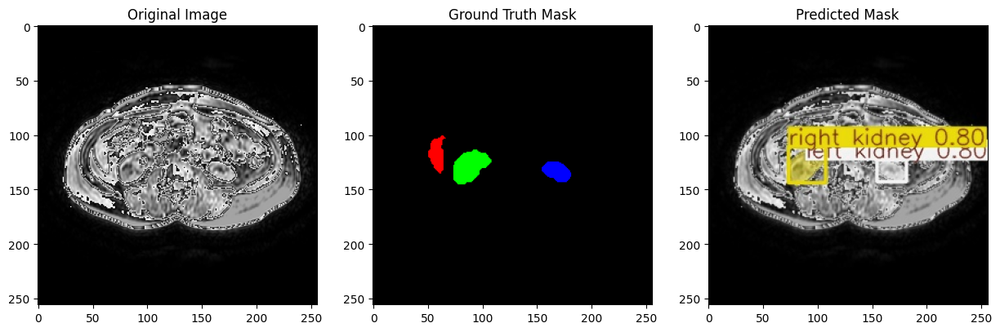

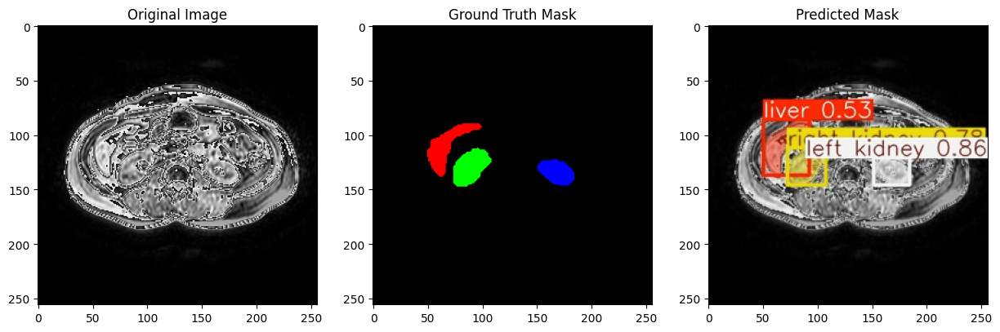

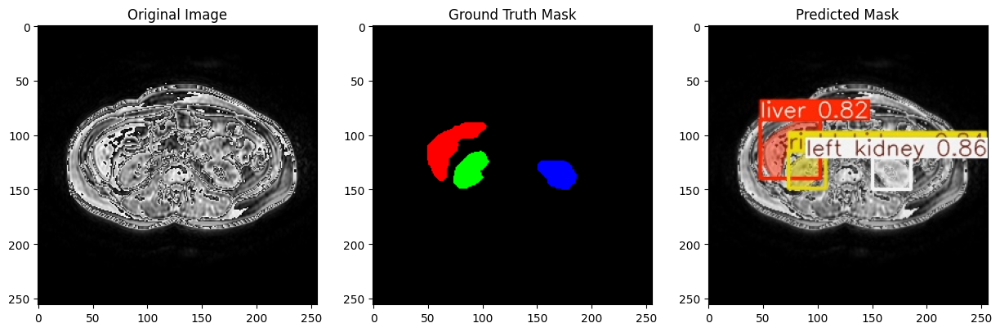

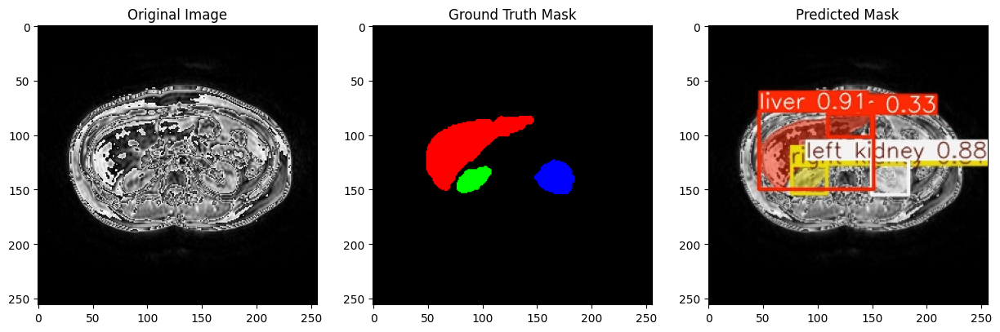

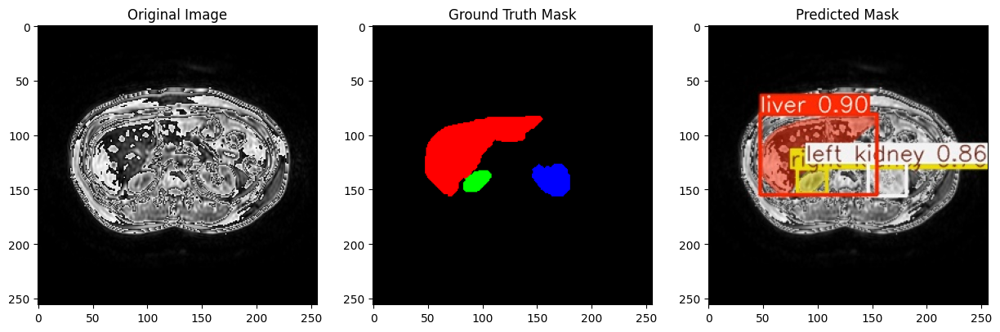

...

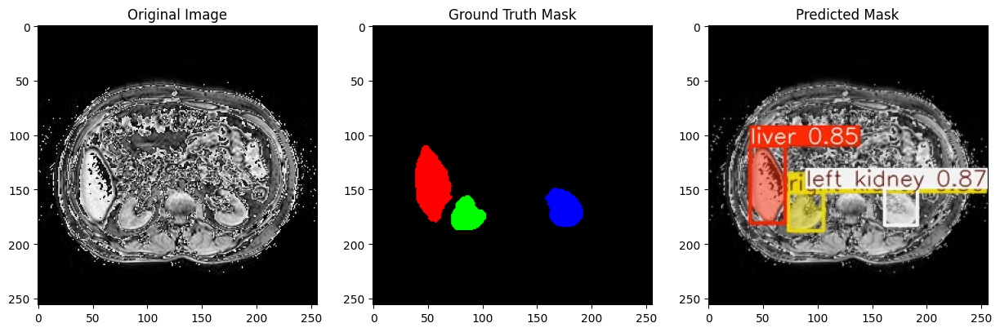

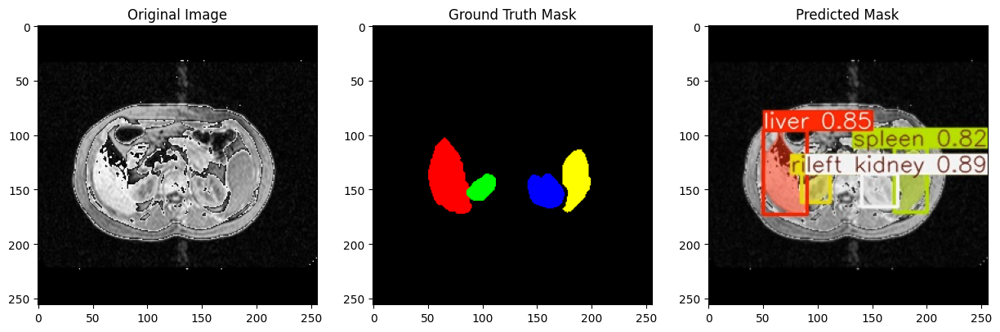

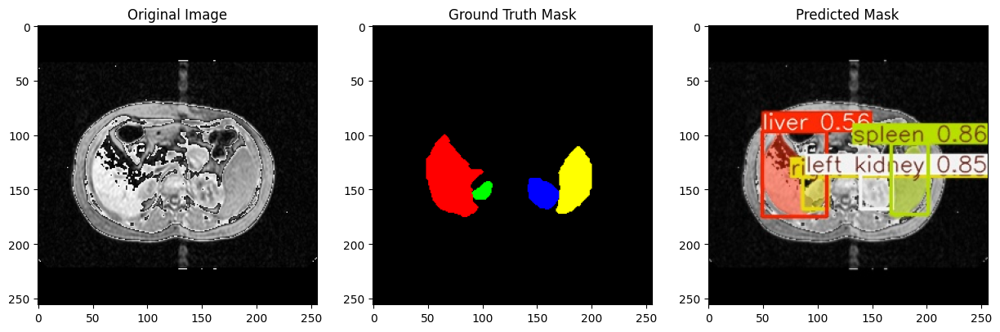

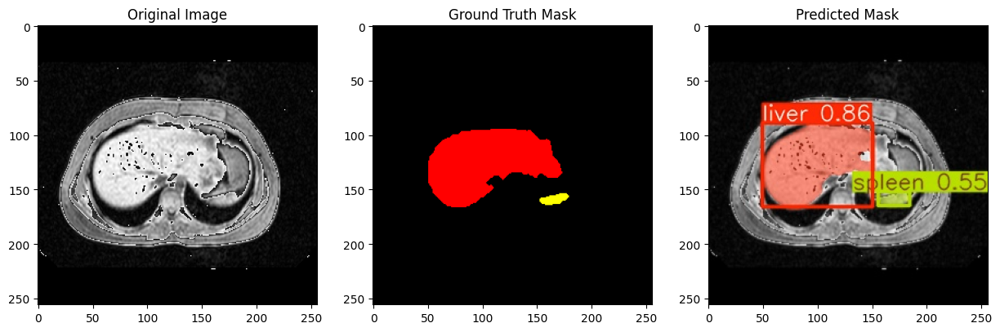

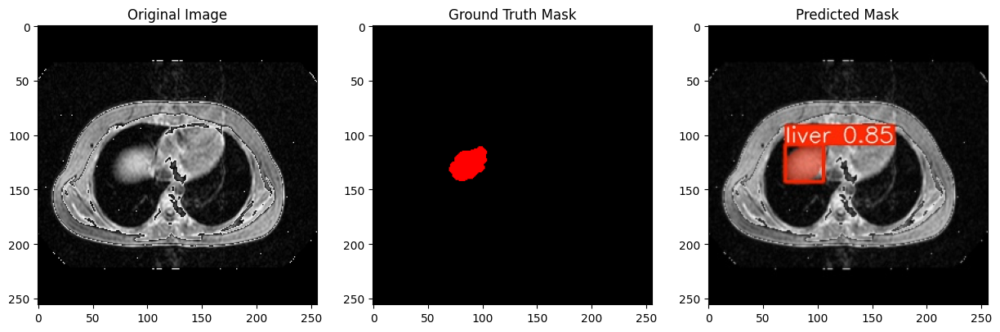

In [20]:
# Define classnames and corresponding colors
classnames = {
    0: "background",
    1: "liver",
    2: "right kidney",
    3: "left kidney",
    4: "spleen",
    5: "unknown"
}

# Define colors for each class (normalized to [0,1] for matplotlib)
colors = {
    0: (0, 0, 0),        # Black - Background
    1: (1, 0, 0),        # Red - Liver
    2: (0, 1, 0),        # Green - Right Kidney
    3: (0, 0, 1),        # Blue - Left Kidney
    4: (1, 1, 0),        # Yellow - Spleen
    5: (1, 0, 1)         # Magenta - Unknown
}

image_path = [os.path.join('/content/chaos_t1_t2/images/test', file) for file in sorted(os.listdir('/content/chaos_t1_t2/images/test'))][:50]
mask_path = [os.path.join('/content/chaos_t1_t2/masks/test', file) for file in sorted(os.listdir('/content/chaos_t1_t2/masks/test'))][:50]
mask_pred_path = [os.path.join('/content/drive/MyDrive/Colab_Notebooks/YOLOv8_1/MultiOrganSegmentation/predict', file) for file in sorted(os.listdir('/content/drive/MyDrive/Colab_Notebooks/YOLOv8_1/MultiOrganSegmentation/predict'))][:50]

for image, mask, mask_pred in zip(image_path, mask_path, mask_pred_path):
    image = cv2.imread(image)
    mask = cv2.imread(mask, 0)
    mask_pred = cv2.imread(mask_pred)

    # Create color-mapped label image
    lab_color = np.zeros((*mask.shape, 3))  # RGB image initialized

    for class_id, color in colors.items():
        lab_color[mask == class_id] = color  # Assign colors to class pixels

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title('Original Image')

    plt.subplot(1, 3, 2)
    plt.imshow(lab_color)
    plt.title('Ground Truth Mask')

    plt.subplot(1, 3, 3)
    plt.imshow(mask_pred)
    plt.title('Predicted Mask')

    plt.show()


0: 384x384 1 right kidney, 1 left kidney, 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 384)


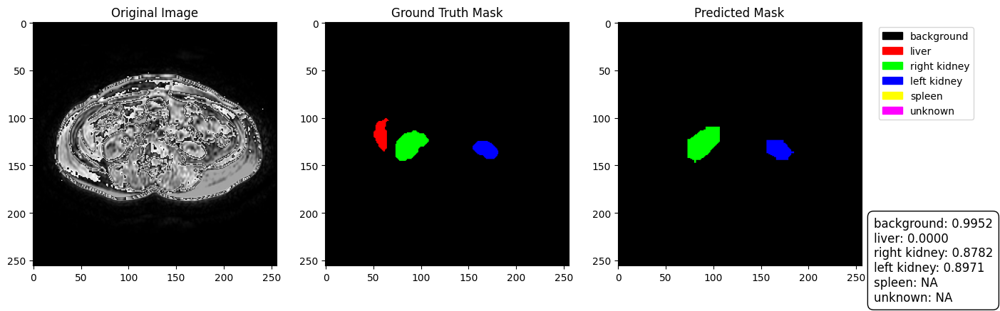


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 46.0ms
Speed: 2.2ms preprocess, 46.0ms inference, 4.4ms postprocess per image at shape (1, 3, 384, 384)


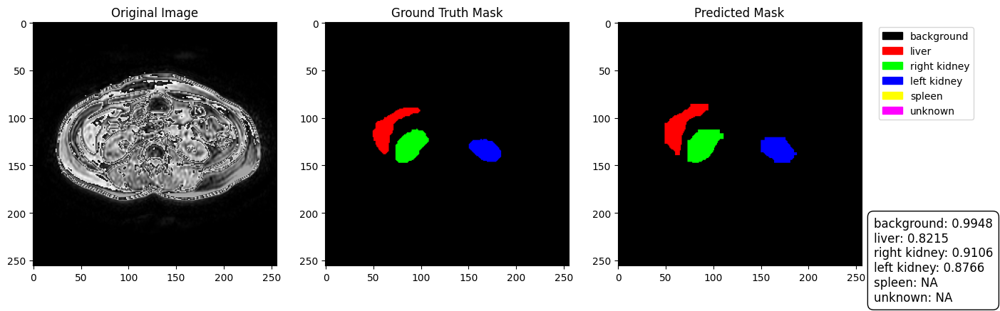


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 83.1ms
Speed: 2.9ms preprocess, 83.1ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 384)


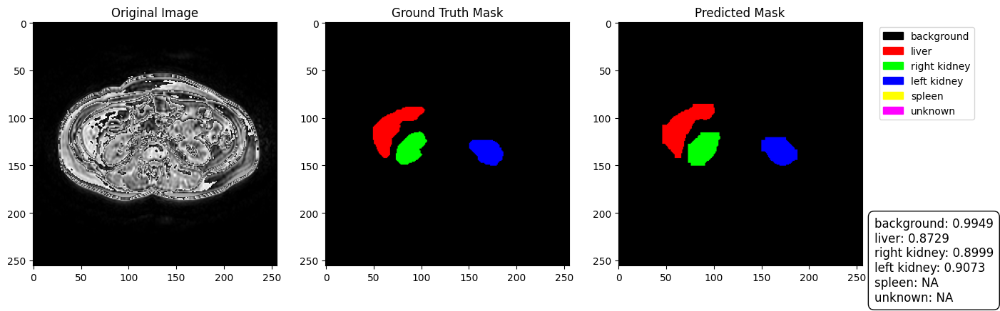


0: 384x384 2 livers, 1 right kidney, 1 left kidney, 22.8ms
Speed: 2.3ms preprocess, 22.8ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 384)


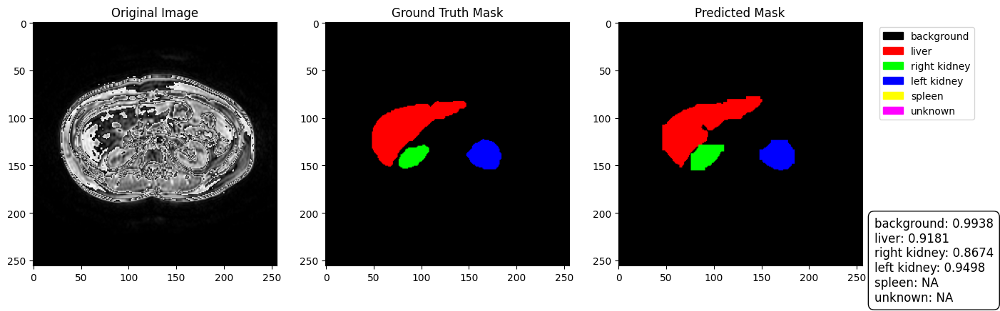


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 29.2ms
Speed: 2.3ms preprocess, 29.2ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 384)


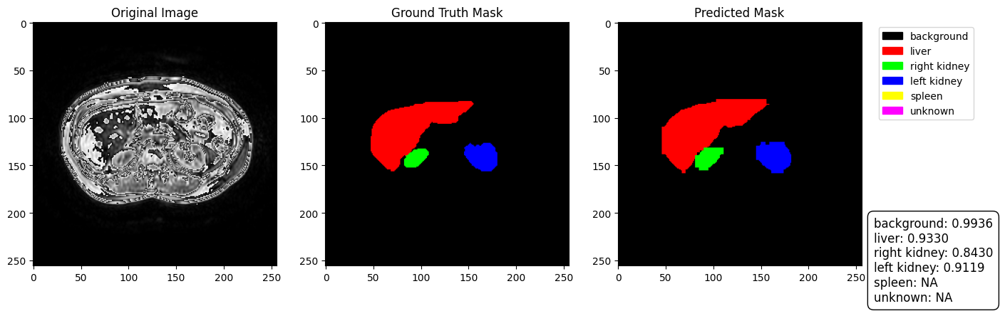


0: 384x384 2 livers, 1 right kidney, 1 left kidney, 24.3ms
Speed: 1.9ms preprocess, 24.3ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 384)


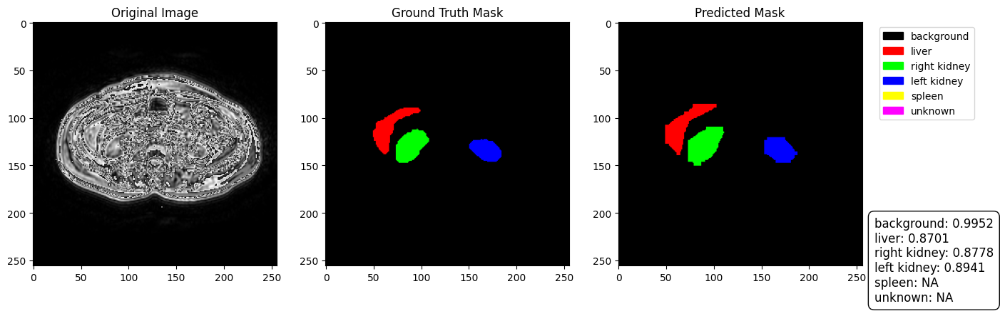


0: 384x384 2 livers, 1 right kidney, 1 left kidney, 24.5ms
Speed: 2.8ms preprocess, 24.5ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 384)


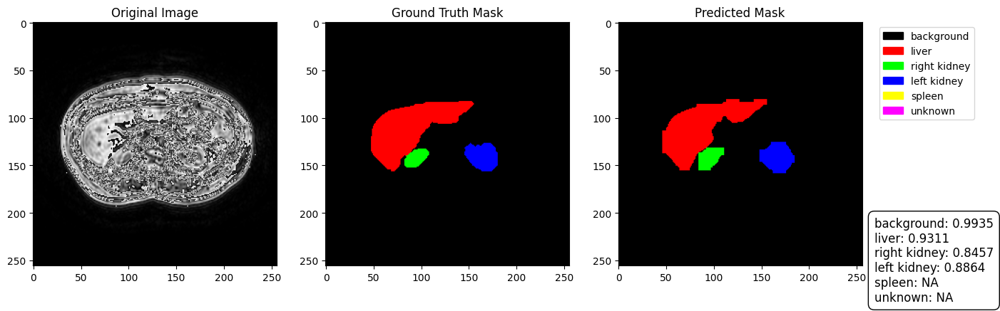


0: 384x384 1 spleen, 28.0ms
Speed: 3.2ms preprocess, 28.0ms inference, 4.0ms postprocess per image at shape (1, 3, 384, 384)


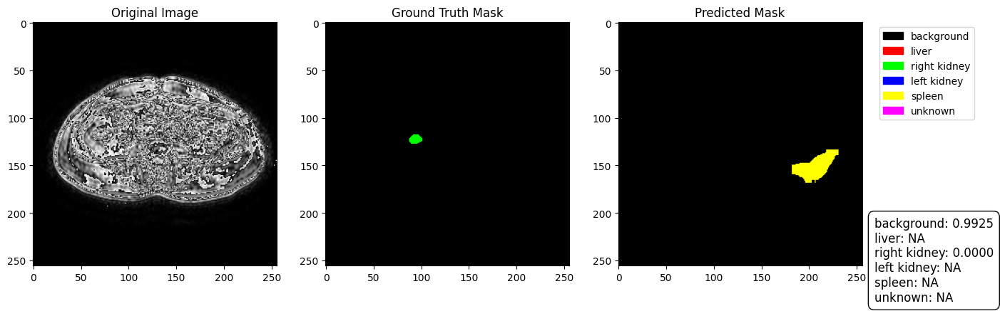


0: 384x384 1 spleen, 30.0ms
Speed: 2.2ms preprocess, 30.0ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 384)


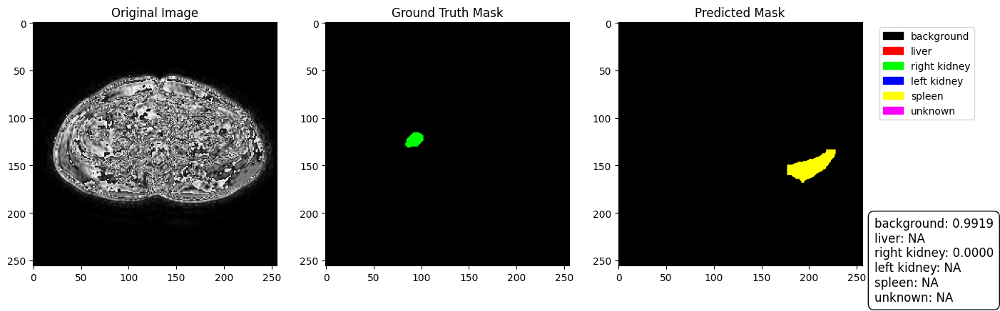


0: 384x384 (no detections), 22.8ms
Speed: 7.2ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 384)


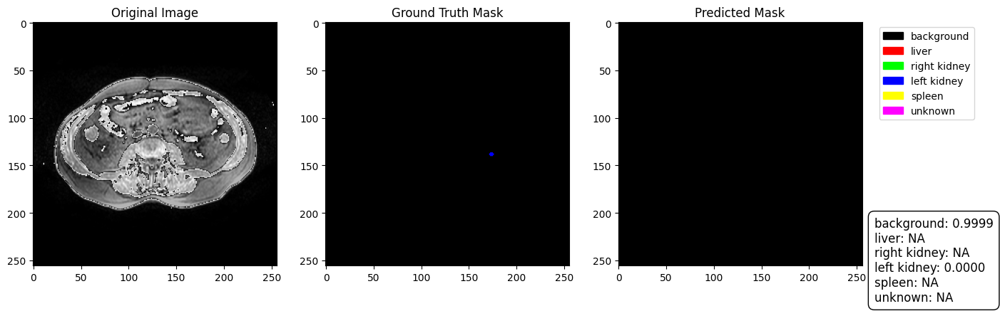


0: 384x384 1 right kidney, 1 left kidney, 24.4ms
Speed: 2.2ms preprocess, 24.4ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 384)


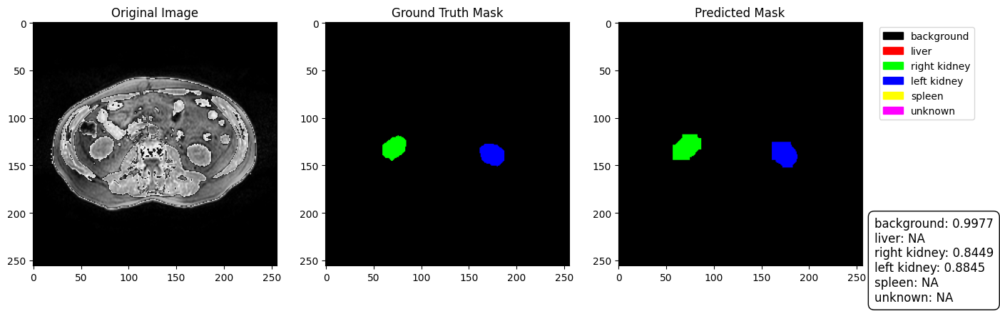


0: 384x384 1 liver, 25.7ms
Speed: 2.1ms preprocess, 25.7ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 384)


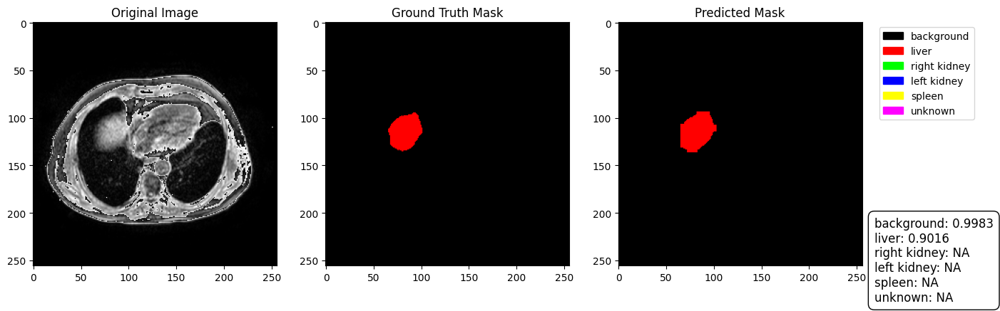


0: 384x384 1 liver, 23.1ms
Speed: 7.1ms preprocess, 23.1ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 384)


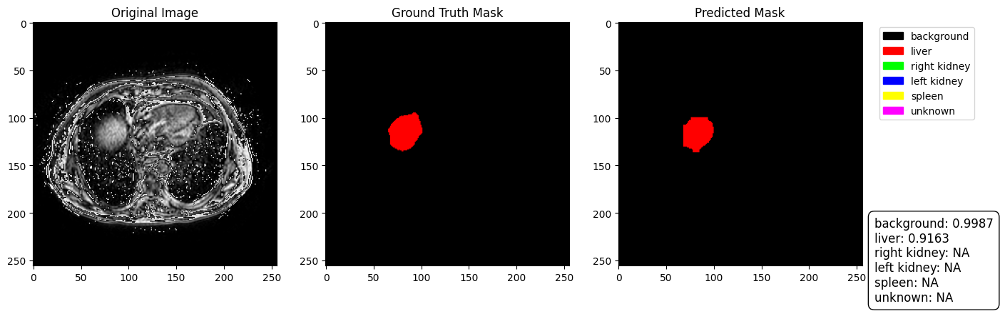


0: 384x384 1 right kidney, 1 left kidney, 24.7ms
Speed: 2.1ms preprocess, 24.7ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


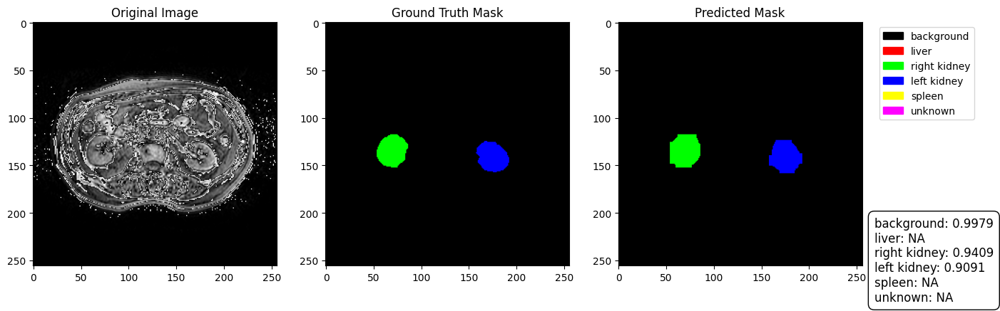


0: 384x384 1 right kidney, 1 left kidney, 22.8ms
Speed: 5.9ms preprocess, 22.8ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 384)


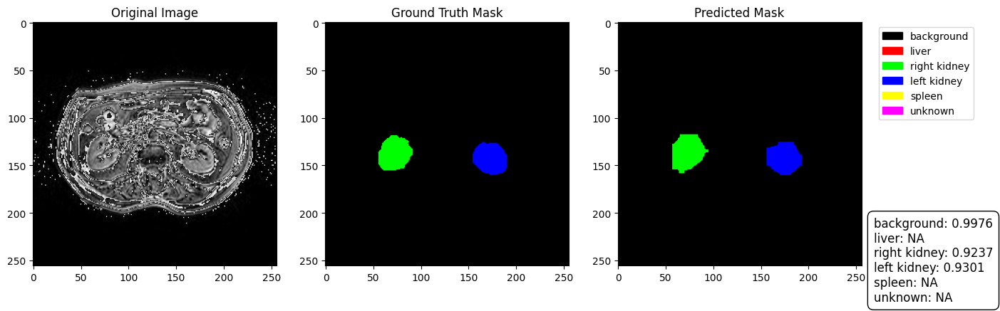


0: 384x384 1 liver, 24.0ms
Speed: 2.0ms preprocess, 24.0ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 384)


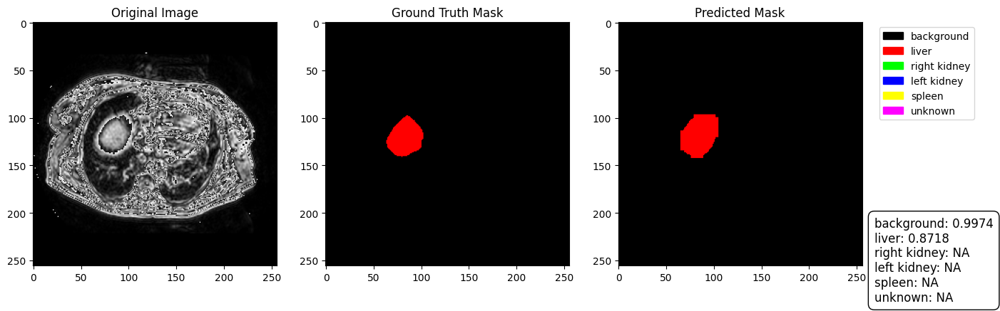


0: 384x384 1 right kidney, 1 left kidney, 1 spleen, 23.3ms
Speed: 2.4ms preprocess, 23.3ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


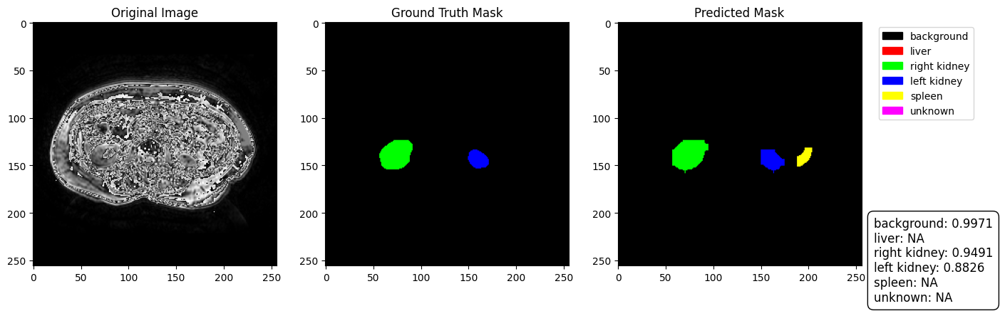


0: 384x384 1 liver, 1 spleen, 25.4ms
Speed: 2.7ms preprocess, 25.4ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 384)


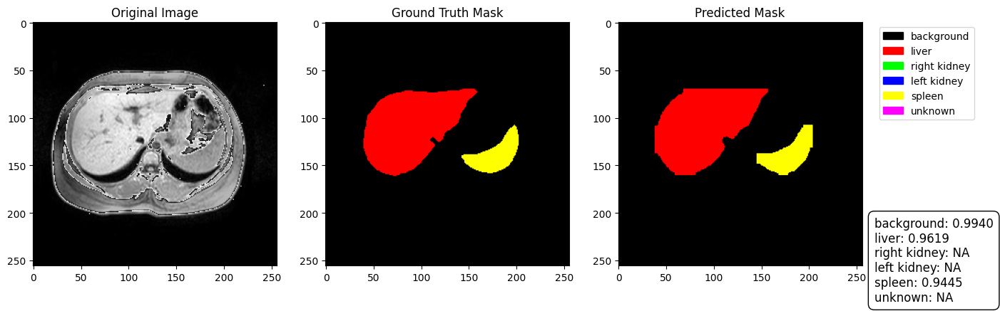


0: 384x384 2 livers, 25.2ms
Speed: 2.5ms preprocess, 25.2ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 384)


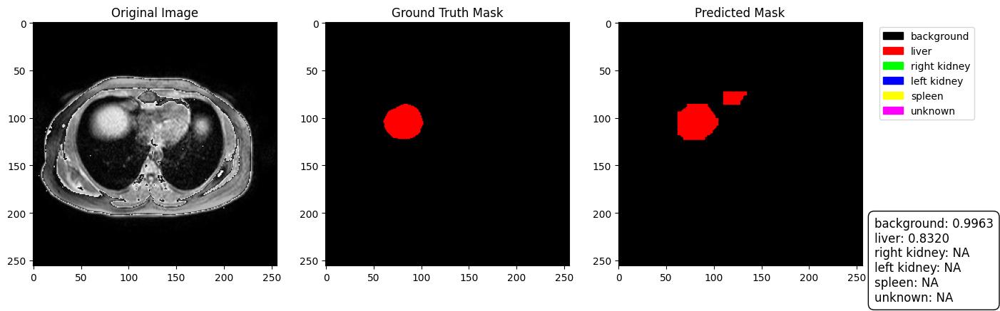


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 24.6ms
Speed: 2.6ms preprocess, 24.6ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 384)


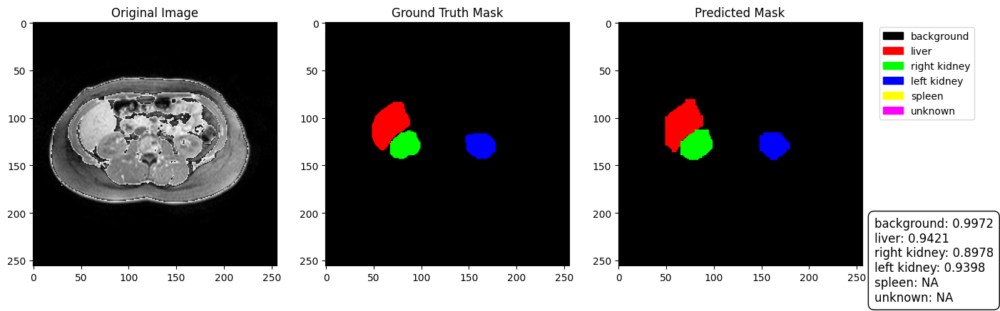


0: 384x384 1 liver, 1 spleen, 32.8ms
Speed: 2.0ms preprocess, 32.8ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


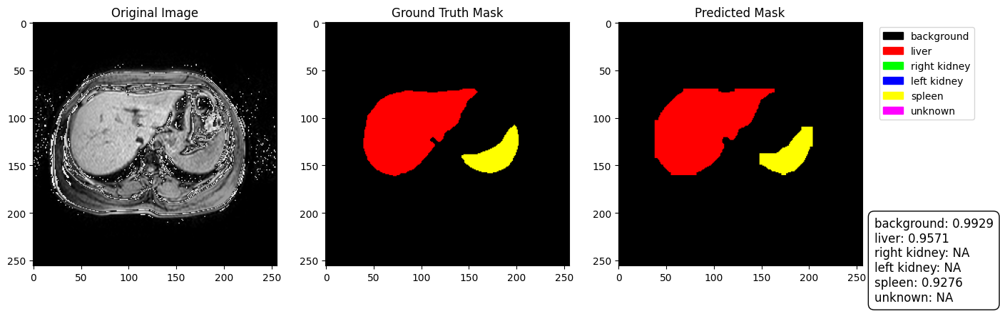


0: 384x384 1 liver, 1 spleen, 28.6ms
Speed: 2.4ms preprocess, 28.6ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


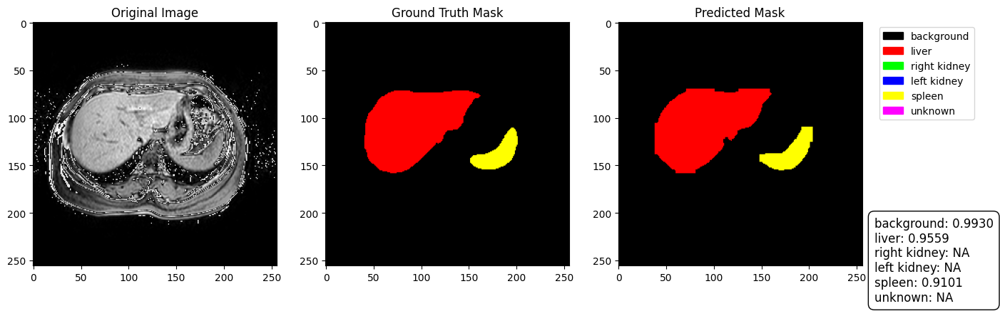


0: 384x384 1 liver, 1 spleen, 25.3ms
Speed: 5.0ms preprocess, 25.3ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 384)


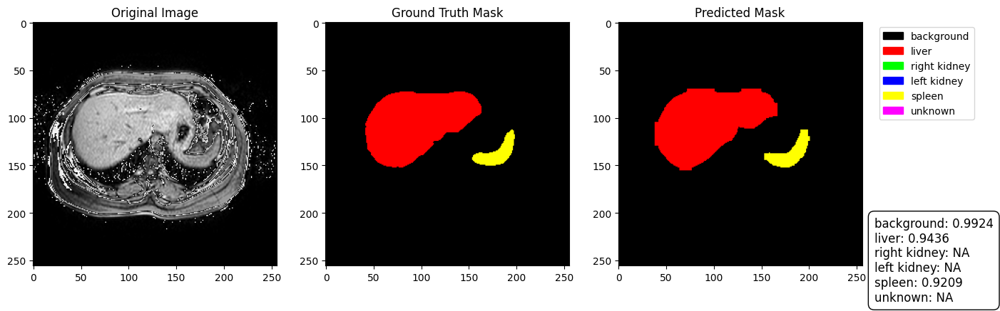


0: 384x384 1 liver, 28.7ms
Speed: 2.2ms preprocess, 28.7ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 384)


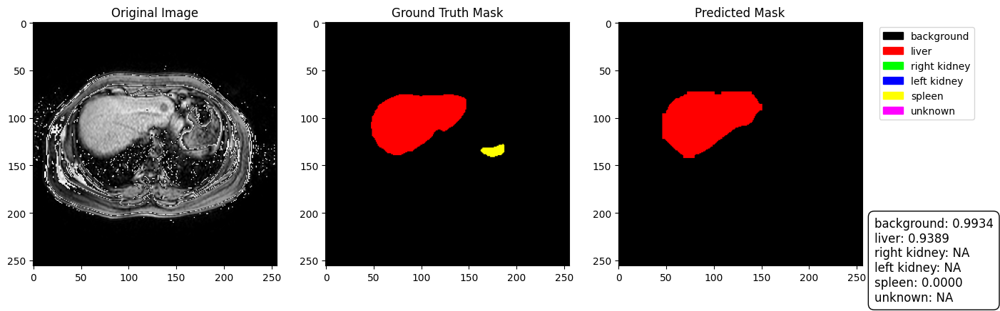


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 24.8ms
Speed: 2.0ms preprocess, 24.8ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 384)


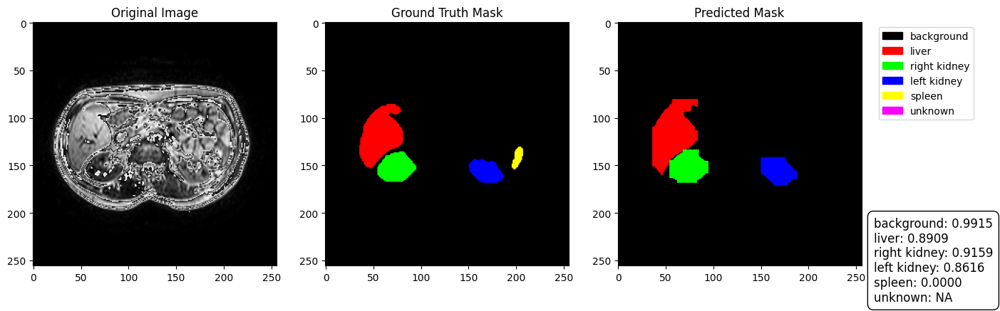


0: 384x384 1 liver, 1 left kidney, 1 spleen, 23.5ms
Speed: 2.3ms preprocess, 23.5ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


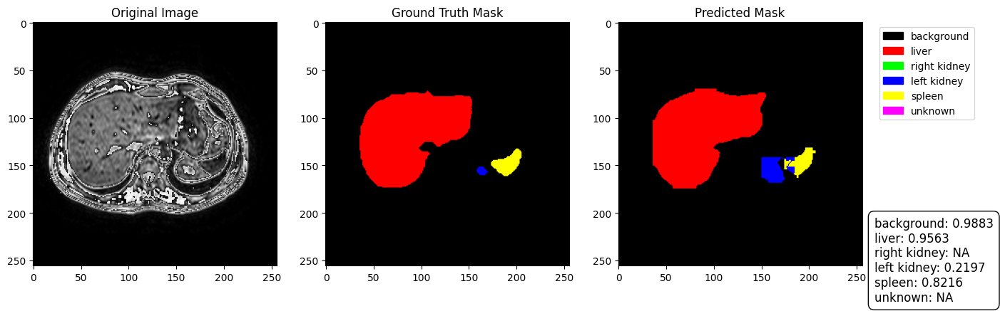


0: 384x384 1 liver, 1 left kidney, 1 spleen, 26.6ms
Speed: 1.8ms preprocess, 26.6ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


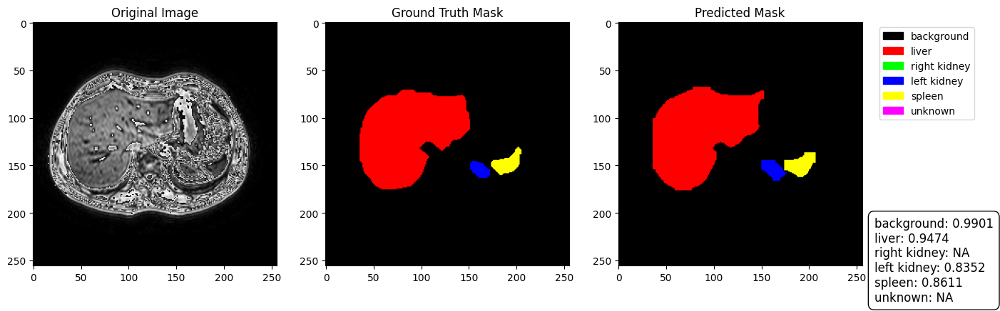


0: 384x384 1 liver, 1 left kidney, 1 spleen, 25.3ms
Speed: 2.0ms preprocess, 25.3ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 384)


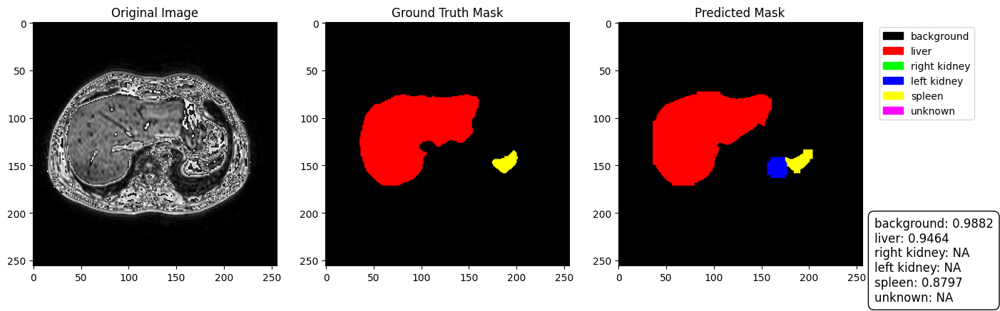


0: 384x384 1 liver, 1 spleen, 23.6ms
Speed: 2.1ms preprocess, 23.6ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 384)


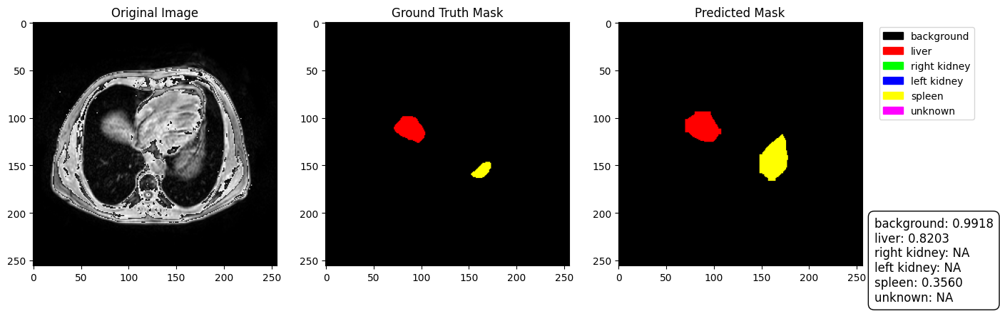


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 1 spleen, 24.2ms
Speed: 2.2ms preprocess, 24.2ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 384)


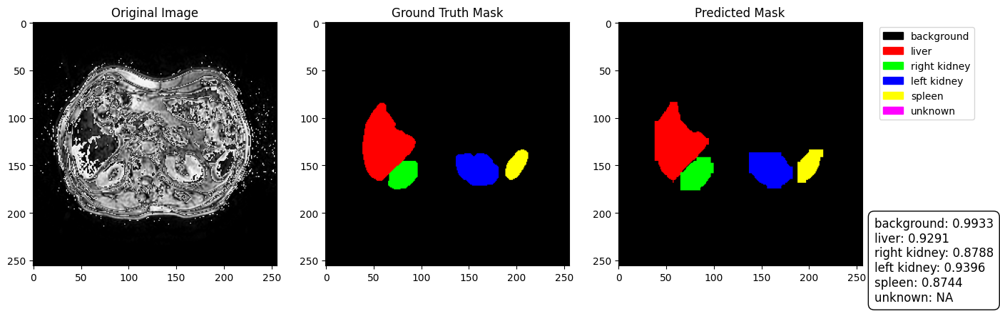


0: 384x384 1 right kidney, 33.0ms
Speed: 2.0ms preprocess, 33.0ms inference, 4.6ms postprocess per image at shape (1, 3, 384, 384)


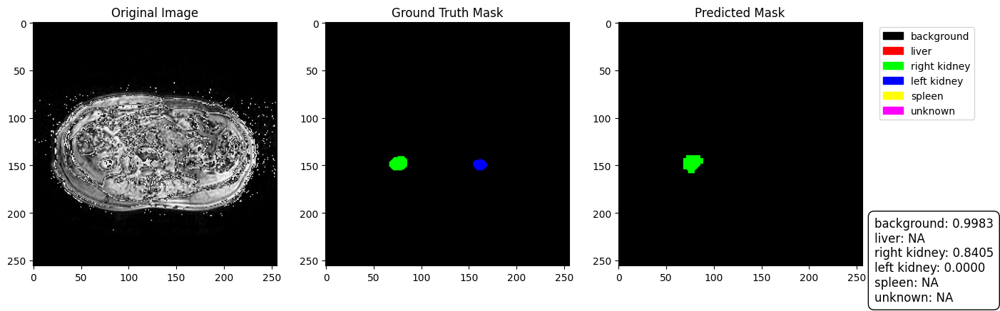


0: 384x384 1 right kidney, 1 left kidney, 22.8ms
Speed: 2.0ms preprocess, 22.8ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 384)


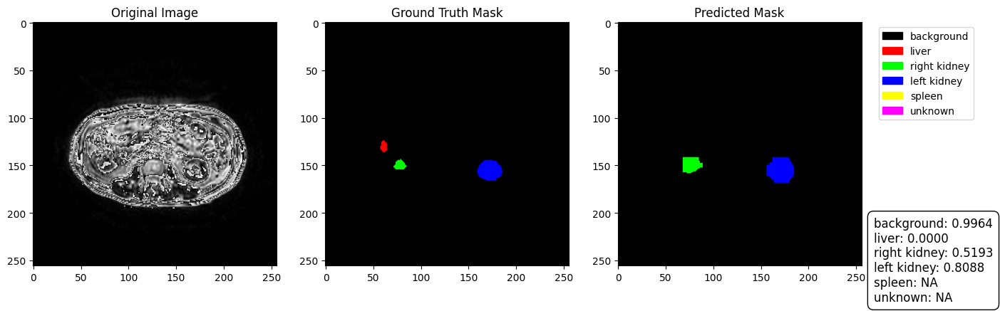


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 24.4ms
Speed: 2.2ms preprocess, 24.4ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 384)


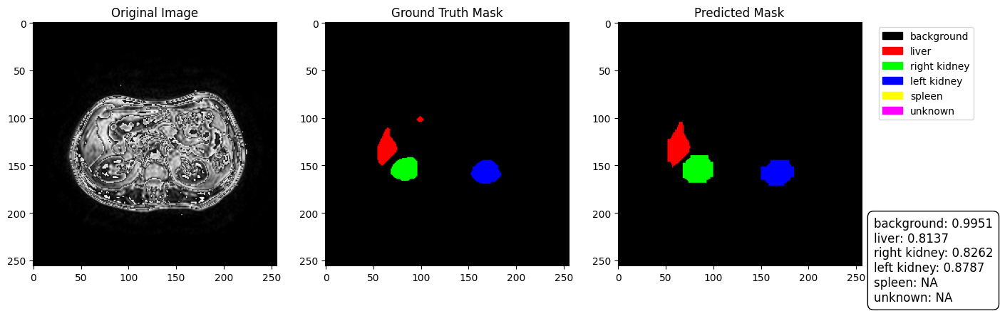


0: 384x384 1 liver, 1 spleen, 36.2ms
Speed: 2.1ms preprocess, 36.2ms inference, 8.5ms postprocess per image at shape (1, 3, 384, 384)


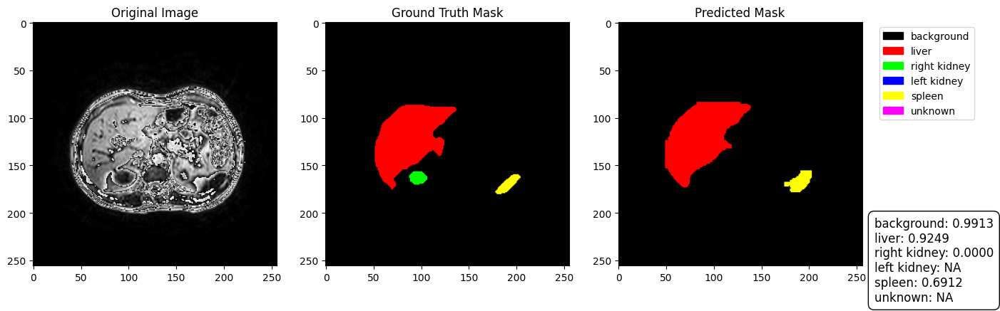


0: 384x384 1 liver, 1 spleen, 36.8ms
Speed: 2.1ms preprocess, 36.8ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 384)


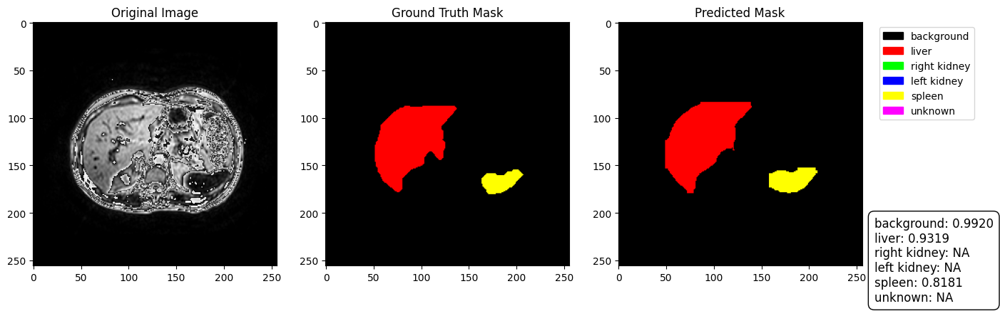


0: 384x384 1 liver, 1 spleen, 28.7ms
Speed: 1.8ms preprocess, 28.7ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


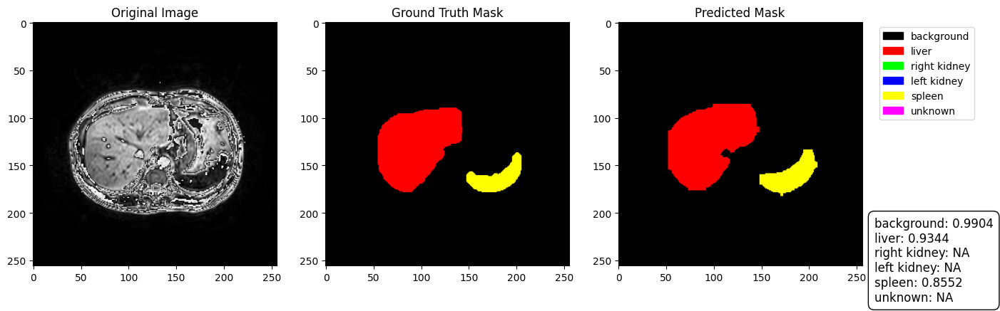


0: 384x384 1 liver, 1 spleen, 29.1ms
Speed: 2.6ms preprocess, 29.1ms inference, 6.3ms postprocess per image at shape (1, 3, 384, 384)


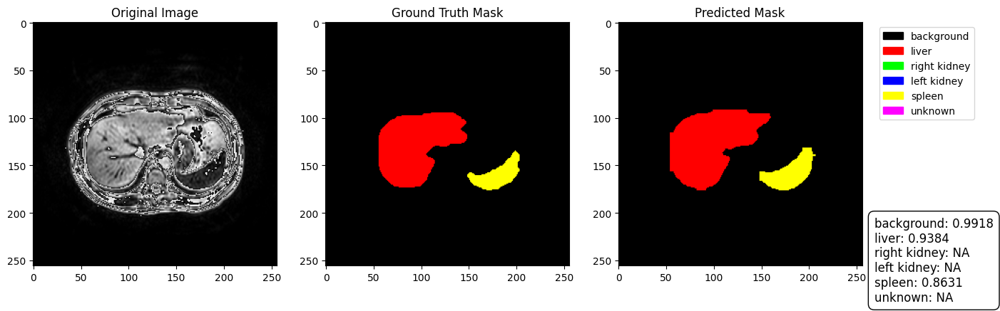


0: 384x384 1 liver, 23.2ms
Speed: 1.9ms preprocess, 23.2ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 384)


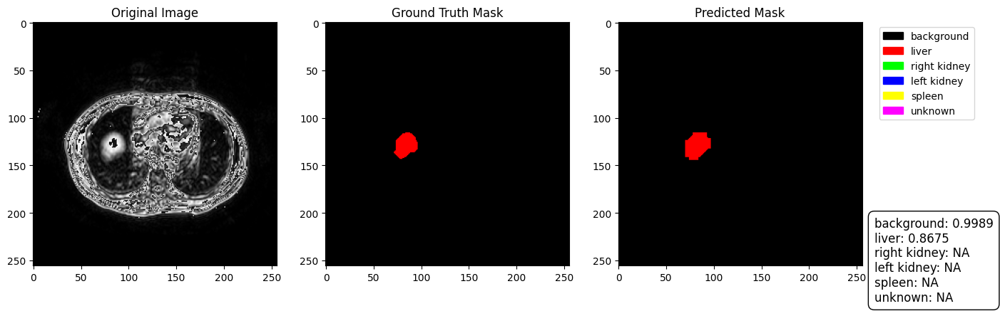


0: 384x384 1 liver, 2 right kidneys, 2 left kidneys, 1 spleen, 23.7ms
Speed: 2.7ms preprocess, 23.7ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 384)


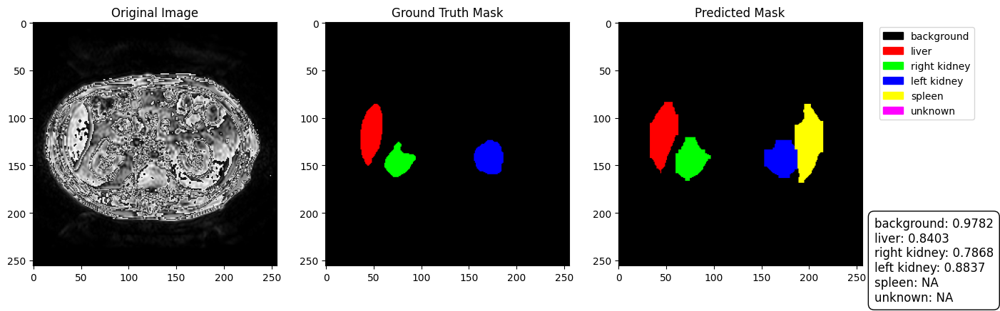


0: 384x384 1 liver, 1 spleen, 22.9ms
Speed: 2.0ms preprocess, 22.9ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 384)


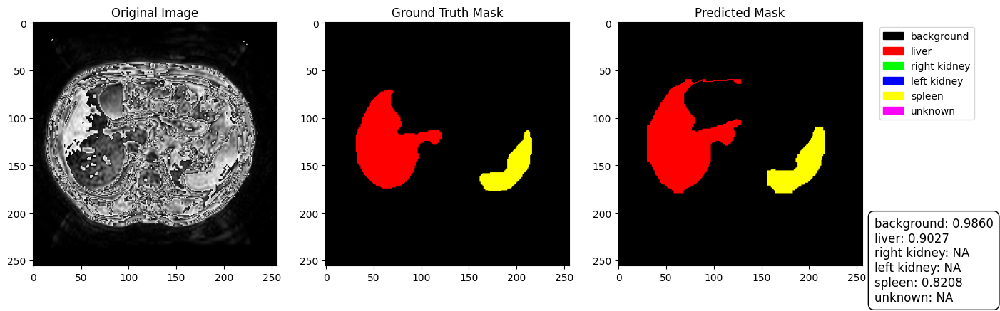


0: 384x384 1 liver, 24.1ms
Speed: 2.2ms preprocess, 24.1ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 384)


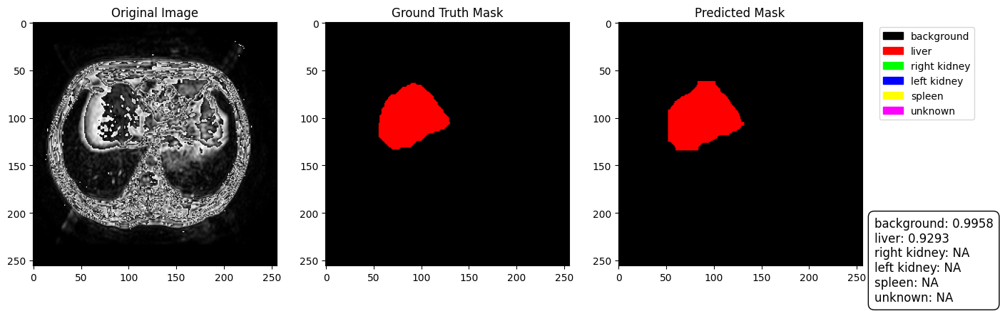


0: 384x384 1 right kidney, 1 left kidney, 24.4ms
Speed: 4.6ms preprocess, 24.4ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


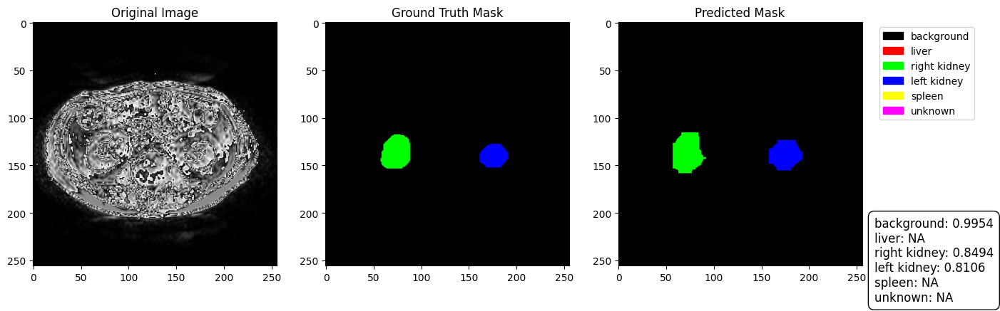


0: 384x384 1 right kidney, 1 left kidney, 25.9ms
Speed: 2.8ms preprocess, 25.9ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 384)


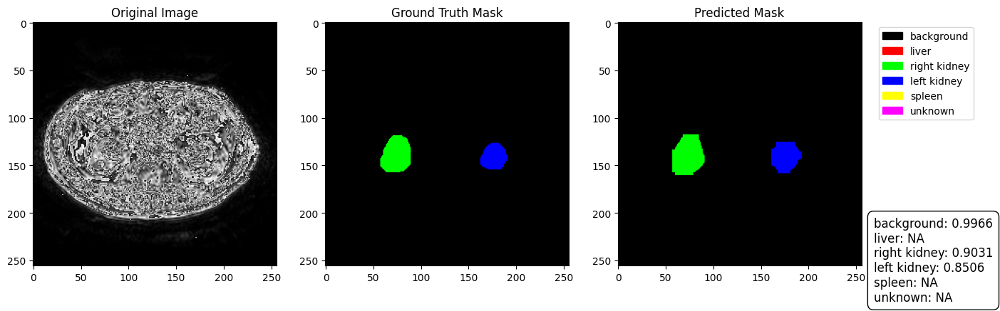


0: 384x384 1 liver, 2 spleens, 22.8ms
Speed: 5.9ms preprocess, 22.8ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 384)


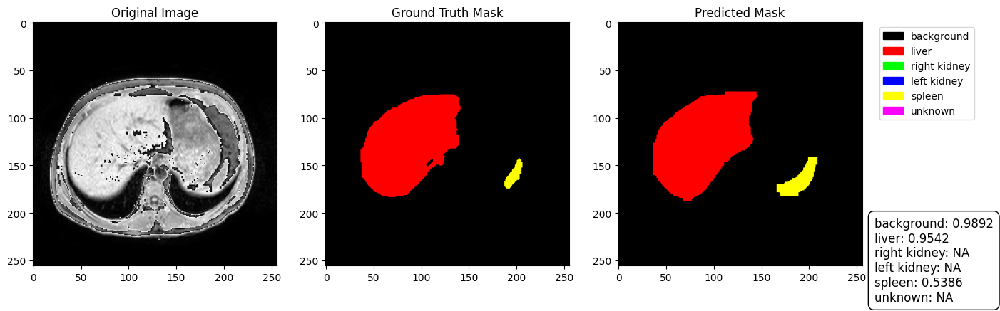


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 23.9ms
Speed: 2.1ms preprocess, 23.9ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 384)


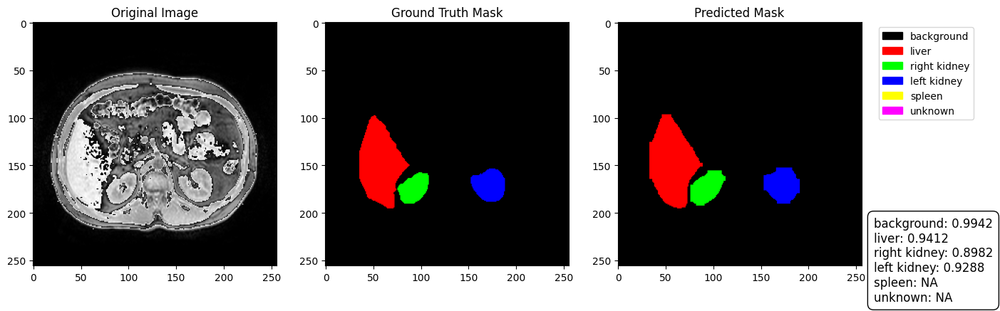


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 30.4ms
Speed: 2.3ms preprocess, 30.4ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


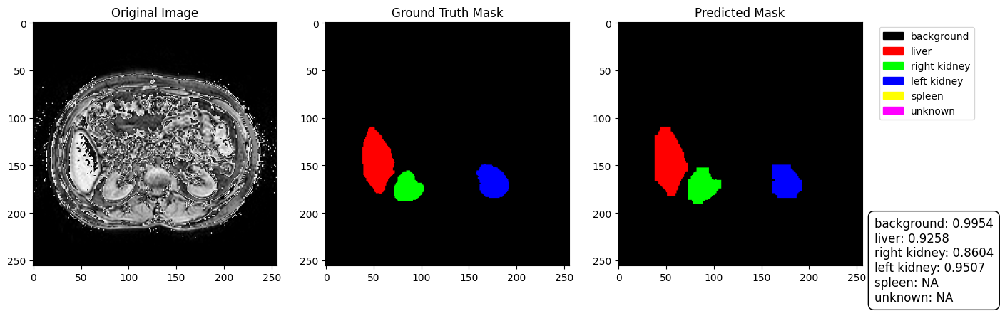


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 1 spleen, 28.6ms
Speed: 2.1ms preprocess, 28.6ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 384)


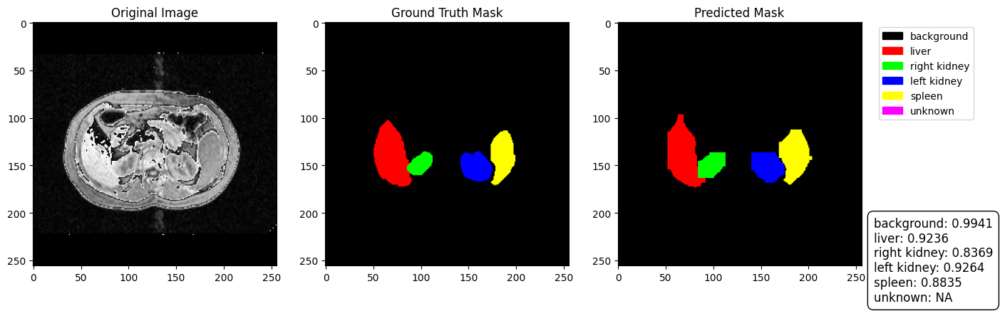


0: 384x384 1 liver, 1 right kidney, 1 left kidney, 1 spleen, 25.3ms
Speed: 2.4ms preprocess, 25.3ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 384)


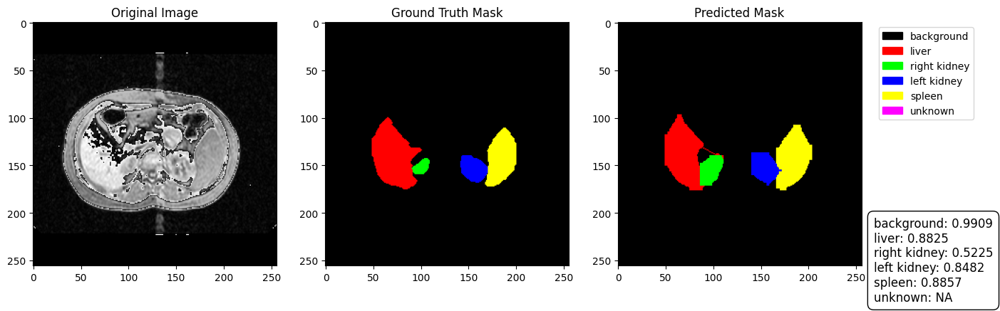


0: 384x384 1 liver, 1 spleen, 23.2ms
Speed: 2.1ms preprocess, 23.2ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 384)


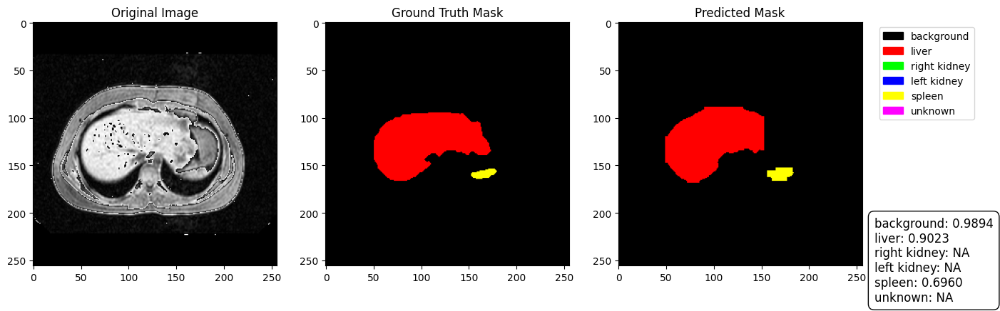


0: 384x384 1 liver, 26.8ms
Speed: 4.0ms preprocess, 26.8ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 384)


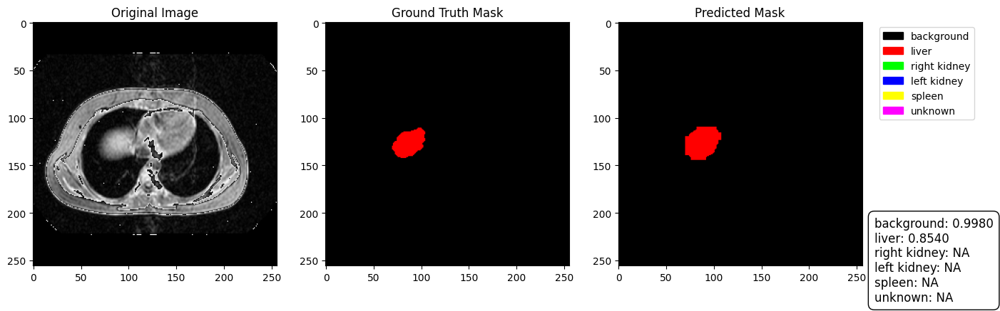

In [40]:
def dice_score(mask_image, predicted_segmented_image, class_id):
    # Create binary masks for the given class
    mask_class = (mask_image == class_id).astype(np.uint8)
    prediction_class = (predicted_segmented_image == class_id).astype(np.uint8)

    # If the class is not present in the ground truth, return 'NA'
    if np.sum(mask_class) == 0:
        return 'NA'

    # Calculate intersection and union
    intersection = np.sum(mask_class * prediction_class)
    union = np.sum(mask_class) + np.sum(prediction_class)

    # Dice score calculation
    if union == 0:
        return 1.0  # No presence of the class in both mask and prediction

    return f"{(2 * intersection / union):.4f}"



# Define classnames and corresponding colors
classnames = {
    0: "background",
    1: "liver",
    2: "right kidney",
    3: "left kidney",
    4: "spleen",
    5: "unknown"
}

# Define colors for each class (normalized to [0,1] for matplotlib)
colors_dict = {
    0: (0, 0, 0),        # Black - Background
    1: (1, 0, 0),        # Red - Liver
    2: (0, 1, 0),        # Green - Right Kidney
    3: (0, 0, 1),        # Blue - Left Kidney
    4: (1, 1, 0),        # Yellow - Spleen
    5: (1, 0, 1)         # Magenta - Unknown
}

image_path = [os.path.join('/content/chaos_t1_t2/images/test', file) for file in sorted(os.listdir('/content/chaos_t1_t2/images/test'))][:50]
mask_path = [os.path.join('/content/chaos_t1_t2/masks/test', file) for file in sorted(os.listdir('/content/chaos_t1_t2/masks/test'))][:50]

model_path = '/content/drive/MyDrive/Colab_Notebooks/YOLOv8_1/MultiOrganSegmentation/train/weights/best.pt'
model=YOLO(model_path)
yolo_classes = list(model.names.values())
classes_ids = [yolo_classes.index(clas) for clas in yolo_classes]

colors = [1,2,3,4]

dice_scores_test = []

for image, mask in zip(image_path, mask_path):
    image = cv2.imread(image)
    mask = cv2.imread(mask, 0)
    pred_mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

    results = model.predict(source=image)

    for result in results:
      if result.masks is None:
        continue
      for mask1, box in zip(result.masks.xy, result.boxes):
          points = np.int32([mask1])
          color_number = classes_ids.index(int(box.cls[0]))
          cv2.fillPoly(pred_mask, points, colors[color_number])

    # Create color-mapped label image
    lab_color = np.zeros((*mask.shape, 3))
    mask_pred = np.zeros((*pred_mask.shape, 3))
    for class_id, color in colors_dict.items():
        lab_color[mask == class_id] = color  # Assign colors to class pixels
        mask_pred[pred_mask == class_id] = color  # Assign colors to class pixels

    # Calculate Dice score for each class
    dice_scores = {}
    for class_id, class_name in classnames.items():
        dice_scores[class_name] = dice_score(mask, pred_mask, class_id)

    dice_scores_test.append(dice_scores)

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title('Original Image')

    plt.subplot(1, 3, 2)
    plt.imshow(lab_color)
    plt.title('Ground Truth Mask')

    plt.subplot(1, 3, 3)
    plt.imshow(mask_pred)
    plt.title('Predicted Mask')

    # Add a legend for labels (Fix)
    legend_patches = [mpatches.Patch(color=colors_dict[class_id], label=name) for class_id, name in classnames.items()]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

    # Add text box with Dice scores
    text_box = '\n'.join([f"{name}: {score}" for name, score in dice_scores.items()])
    plt.gca().text(1.05, 0.2, text_box, transform=plt.gca().transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', edgecolor='black', boxstyle='round,pad=0.5'))


    plt.show()

In [43]:
import numpy as np

# List of Dice score dictionaries for 50 images
dice_scores_list = dice_scores_test

# Initialize a dictionary to store scores for each class
aggregated_scores = {name: [] for name in classnames.values()}

# Collect valid scores (ignore 'NA')
for dice_scores in dice_scores_list:
    for class_name, score in dice_scores.items():
        if score != 'NA':  # Ignore 'NA' values
            aggregated_scores[class_name].append(float(score))  # Convert to float for computation

# Compute mean Dice scores for each class
mean_dice_scores = {class_name: (np.mean(scores) if scores else 'NA') for class_name, scores in aggregated_scores.items()}

# Print results
for class_name, mean_score in mean_dice_scores.items():
    print(f"{class_name}: {mean_score if mean_score == 'NA' else f'{mean_score:.4f}'}")

# Exclude 'background' and 'unknown' from mean calculation
filtered_scores = [score for class_name, score in mean_dice_scores.items()
                   if class_name not in ["background", "unknown"] and score != 'NA']

# Compute overall mean Dice score for the remaining classes
overall_mean_dice = np.mean(filtered_scores) if filtered_scores else 'NA'

print(f"Mean Dice Score (excluding 'background' & 'unknown'): {overall_mean_dice if overall_mean_dice == 'NA' else f'{overall_mean_dice:.4f}'}")

background: 0.9938
liver: 0.8631
right kidney: 0.7525
left kidney: 0.8004
spleen: 0.7274
unknown: NA
Mean Dice Score (excluding 'background' & 'unknown'): 0.7859
